# **Лабораторная работа 2**


1. кол-во особей в начальной популяции и размеры квадрата (по-умолчанию -20 до 20, но работать должны на любых (т.е. размер должен задаваться динамически))
2. отбор (селекция) (что-то типо метрик)

a) Турнирная селекция — сначала случайно выбирается установленное количество особей (обычно две), а затем из них выбирается особь с лучшим значением функции приспособленности.

б) Метод рулетки — вероятность выбора особи тем вероятнее, чем лучше её значение функции приспособленности.

в) Метод ранжирования — вероятность выбора зависит от места в списке особей отсортированном по значению функции приспособленности.

г) Равномерное ранжирование — заданное количество более приспособленных особей имеют равные вероятности.

д) Сигма-отсечение

е) можно добавить свой

3. выбор родителей
1) по умолчанию (панмиксия)

2) на выбор (инбридинг)

3) на выбор (аутбридинг)

4. Размножение (метод, зависящий от родителя)

5. Мутации - порог p = 0,1 (по-умолчанию, но должно меняться, т. е. быть динамическим) (вероятность как произойдёт мутация)
Ефимов сказал, что это нужно осуществить как написано в его лекции




Нам дана формула:
$
\frac{1}{|x| + 4} + \frac{3}{y^2 + 4}
$
, определенная на участке:

 D = {(x, y) : x ∈ [−20, 20], y ∈ [−20, 20]}


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from mpl_toolkits.mplot3d import Axes3D
import random
from functools import partial
from typing import List, Tuple, Callable,  Dict

Создаем функцию, содержащую нашу формулу

In [ ]:
def f(x, y):
    return 1 / (abs(x) + 4) + 3 / (y**2 + 4)


## Функция для визуализации формулы

In [ ]:
def plot_not_norml(f):
  fig = plt.figure(figsize=(12, 6), dpi=200)

    # Первый график (wireframe)
  ax1 = fig.add_subplot(1, 2, 1, projection='3d')
  X = np.arange(-20, 20, 0.25)
  Y = np.arange(-20, 20, 0.25)
  X, Y = np.meshgrid(X, Y)
  Z = f(X, Y)
  ax1.plot_wireframe(X, Y, Z, rstride=10, cstride=10)
  ax1.set_xlabel('x')
  ax1.set_ylabel('y')
  ax1.set_zlabel('z')
  ax1.set_title('Wireframe')

  # Второй график (surface)
  ax2 = fig.add_subplot(1, 2, 2, projection='3d')
  x = np.linspace(-20, 20, 40)
  y = np.linspace(-20, 20, 40)
  X, Y = np.meshgrid(x, y)
  Z = f(X, Y)
  ax2.plot_surface(X, Y, Z, cmap='viridis')
  ax2.set_xlabel('x')
  ax2.set_ylabel('y')
  ax2.set_zlabel('z')
  ax2.set_title('Surface')

  # Показ графика
  plt.show()

1. Создание начальной популяции

2. Отбор (селекция)

    a) Турнирная селекция — сначала случайно выбирается установленное количество особей (обычно две), а затем из них выбирается особь с лучшим значением функции приспособленности.
    
    b) Метод рулетки — вероятность выбора особи тем вероятнее, чем лучше её значение функции приспособленности.
    
    c) Метод ранжирования — вероятность выбора зависит от места в списке особей отсортированном по значению функции приспособленности.
    
    d) Равномерное ранжирование — заданное количество более приспособленных особей имеют равные вероятности.
    
    e) Сигма-отсечение — для предотвращения преждевременной сходимости генетического алгоритма используются методы, масштабирующие значение целевой функции. Вероятность выбора особи тем больше, чем оптимальнее значение масштабируемой целевой функции
${p_{i}={\frac {F_{i}}{\sum\limits_{i=1}^{N}{F_{i}}}}} $, где $ { F_{i}=1+{\frac {f_{i}-f_{avg}}{2\sigma }}}, f_{avg} $ — среднее значение целевой функции для всей популяции, σ — среднеквадратичное отклонение значения целевой функции.

3. Выбор родителей

    a) Панмиксия — оба родителя выбираются случайно, каждая особь популяции имеет равные шансы быть выбранной.
    
    b) Инбридинг — первый родитель выбирается случайно, а вторым выбирается такой, который наиболее похож на первого родителя.
    
    c) Аутбридинг — первый родитель выбирается случайно, а вторым выбирается такой, который наименее похож на первого родителя.

4. Размножение (скрещивание)

5. Мутации

# **Класс - генетический способ**

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
import random
from typing import Callable, Tuple, List, Union

class GeneticAlgorithm:
    def __init__(self, fitness_func: Callable, # целевая функция для оптимизации
                 population_size: int = 50,     #размер популяции
                 bounds: Tuple[float, float] = (-20, 20), # границы пространства поиска
                 mutation_prob: float = 0.1,     #вероятность мутации особи
                 parent_selection_method: str = 'panmixia', #Методы выбора родителей и селекции
                 selection_method: str = 'tournament',
                 tournament_size: int = 2,
                 sigma: float = 1.0,
                 visualize_step: int = 5):

        self.fitness_func = fitness_func
        self.population_size = population_size
        self.bounds = bounds
        self.mutation_prob = mutation_prob
        self.parent_selection_method = parent_selection_method
        self.selection_method = selection_method
        self.tournament_size = tournament_size
        self.sigma = sigma
        self.visualize_step = visualize_step
         #Создает начальную популяцию и инициализирует историю лучших решений
        self.population = self.create_initial_population()
        self.best_history = []
        self.avg_history = []


    def create_initial_population(self) -> np.ndarray: #Возвращает numpy массив размером (population_size, 3)
        population = []       #Создает массив случайных особей (x, y, z=f(x,y))
        while len(population) < self.population_size:
            x = random.uniform(self.bounds[0], self.bounds[1])
            y = random.uniform(self.bounds[0], self.bounds[1])
            z = self.fitness_func(x, y)
            if [x, y, z] not in population:
                population.append([x, y, z])
        return np.array(population)   #Возвращает numpy массив размером (population_size, 3)

#с заданной вероятностью добавляет случайное нормально распределенное изменение к координатам особи
    def mutate(self, individual: np.ndarray) -> np.ndarray:
        mutated = individual.copy()
        if random.random() < self.mutation_prob:
            mutation = np.random.normal(0, 0.5, size=2)
            mutated[:2] = np.clip(mutated[:2] + mutation, self.bounds[0], self.bounds[1])#Использует clipping для сохранения значений в заданных границах
            mutated[2] = self.fitness_func(mutated[0], mutated[1])#Пересчитывает значение функции после мутации
        return mutated

#------------------------------------

#МЕТОДЫ СЕЛЕКЦИИ

#------------------------------------


#выбирает победителей в "турнирах" между случайными особями
    def tournament_selection(self) -> np.ndarray:
        selected = []
        for _ in range(self.population_size):
            contestants = random.choices(self.population, k=self.tournament_size)
            winner = min(contestants, key=lambda x: x[2])
            selected.append(winner)
        return np.array(selected)

#вероятность выбора особи обратно пропорциональна значению функции (для минимизации)
    def roulette_selection(self) -> np.ndarray:
        fitness_values = np.array([ind[2] for ind in self.population])
        inverted_fitness = 1 / (fitness_values + 1e-6)
        total = np.sum(inverted_fitness)
        probs = inverted_fitness / total if total > 0 else np.ones(len(self.population)) / len(self.population)
        selected_indices = np.random.choice(len(self.population), size=self.population_size, p=probs)
        return self.population[selected_indices]

#особи сортируются, вероятность выбора зависит от ранга
    def ranking_selection(self) -> np.ndarray:
        sorted_population = self.population[self.population[:, 2].argsort()]
        ranks = np.arange(len(sorted_population), 0, -1)
        probs = ranks / np.sum(ranks)
        selected_indices = np.random.choice(len(sorted_population), size=self.population_size, p=probs)
        return sorted_population[selected_indices]

#выбор только из лучшей половины популяции
    def uniform_ranking_selection(self) -> np.ndarray:
        sorted_population = self.population[self.population[:, 2].argsort()]
        top_n = len(sorted_population) // 2
        selected_indices = np.random.choice(top_n, size=self.population_size)
        return sorted_population[selected_indices]

#учитывает стандартное отклонение значений функции
    def sigma_scaling_selection(self) -> np.ndarray:
        fitness_values = np.array([ind[2] for ind in self.population])
        mean = np.mean(fitness_values)
        std = np.std(fitness_values)

        if std < 1e-6:
            return self.population

        scaled_fitness = np.maximum(0, (fitness_values - mean) / (self.sigma * std) + 1)
        total = np.sum(scaled_fitness)

        if total < 1e-6:
            return self.population

        probs = scaled_fitness / total
        selected_indices = np.random.choice(len(self.population), size=self.population_size, p=probs)
        return self.population[selected_indices]

#------------------------------------

#ВЫБОР РОДИТЕЛЕЙ

#------------------------------------

#Использует евклидово расстояние между координатами особей
    def select_parents(self) -> Tuple[np.ndarray, np.ndarray]:
        if self.parent_selection_method == 'panmixia':  #полностью случайный выбор
            parent1, parent2 = random.choices(self.population, k=2)
        elif self.parent_selection_method == 'inbreeding':  #выбирает наиболее похожих особей
            idx1 = random.randint(0, len(self.population)-1)
            distances = [np.linalg.norm(self.population[idx1,:2] - ind[:2]) for ind in self.population]
            distances[idx1] = float('inf')
            idx2 = np.argmin(distances)
            parent1, parent2 = self.population[idx1], self.population[idx2]
        elif self.parent_selection_method == 'outbreeding':   #выбирает наиболее отличающихся особей
            idx1 = random.randint(0, len(self.population)-1)
            distances = [np.linalg.norm(self.population[idx1,:2] - ind[:2]) for ind in self.population]
            distances[idx1] = -1
            idx2 = np.argmax(distances)
            parent1, parent2 = self.population[idx1], self.population[idx2]
        else:
            raise ValueError("Неизвестный метод выбора родителей")
        return parent1, parent2

    def crossover(self, parent1: np.ndarray, parent2: np.ndarray) -> Tuple[np.ndarray, np.ndarray]:
        """
        Оператор кроссовера (скрещивания).

        Создает двух потомков, комбинируя признаки родителей:
        - Первый потомок: x от parent1, y от parent2
        - Второй потомок: x от parent2, y от parent1
        Параметры:
            parent1: Первый родитель [x, y, z]
            parent2: Второй родитель [x, y, z]
        """
        # Создаем потомков
        child1 = np.array([parent1[0], parent2[1], 0.0])
        child2 = np.array([parent2[0], parent1[1], 0.0])

        # Вычисляем значения функции для потомков
        child1[2] = self.fitness_func(child1[0], child1[1])
        child2[2] = self.fitness_func(child2[0], child2[1])

        return child1, child2


#выполняет эволюцию заданное число поколений
#В каждом поколении:Применяет выбранный метод селекции, Создает новое поколение через кроссовер и мутации, Сохраняет лучшую особь (элитизм), Записывает статистику
    def evolve(self, generations: int = 100, verbose: bool = True) -> None:
        for gen in range(generations):
            # Выбор метода селекции
            if self.selection_method == 'tournament':
                selected = self.tournament_selection()
            elif self.selection_method == 'roulette':
                selected = self.roulette_selection()
            elif self.selection_method == 'ranking':
                selected = self.ranking_selection()
            elif self.selection_method == 'uniform_ranking':
                selected = self.uniform_ranking_selection()
            elif self.selection_method == 'sigma':
                selected = self.sigma_scaling_selection()
            else:
                raise ValueError("Неизвестный метод селекции")

            # Скрещивание и мутация
            new_population = []
            for _ in range(self.population_size // 2):
                parent1, parent2 = self.select_parents()
                child1, child2 = self.crossover(parent1, parent2)
                new_population.extend([self.mutate(child1), self.mutate(child2)])

            # Элитизм - сохраняем лучшую особь
            best_individual = min(self.population, key=lambda x: x[2])
            new_population[0] = best_individual

            self.population = np.array(new_population)
            self.population = self.population[self.population[:, 2].argsort()]

            # Сохранение статистики
            best_fitness = self.population[0, 2]
            avg_fitness = np.mean(self.population[:, 2])
            self.best_history.append(best_fitness)
            self.avg_history.append(avg_fitness)

            if verbose and (gen % self.visualize_step == 0 or gen == generations-1):
                print(f"Поколение {gen+1}: Лучшее значение = {best_fitness:.4f}, Среднее = {avg_fitness:.4f}")
                self.visualize_population(title=f"Поколение {gen+1}")

    def visualize_population(self, title: str = "") -> None:
        fig = plt.figure(figsize=(14, 6))

        # 3D график
        ax1 = fig.add_subplot(121, projection='3d')
        X, Y = np.meshgrid(np.linspace(*self.bounds, 50),
                          np.linspace(*self.bounds, 50))
        Z = self.fitness_func(X, Y)
        ax1.plot_surface(X, Y, Z, cmap=cm.coolwarm, alpha=0.7)
        ax1.scatter(self.population[:, 0], self.population[:, 1], self.population[:, 2],
                   color='black', s=50, label='Особи')
        ax1.set_xlabel('X')
        ax1.set_ylabel('Y')
        ax1.set_zlabel('Z')
        ax1.set_title(f'Популяция\n{title}')

        # График сходимости
        ax2 = fig.add_subplot(122)
        ax2.plot(self.best_history, label='Лучшее значение')
        ax2.plot(self.avg_history, label='Среднее значение')
        ax2.set_xlabel('Поколение')
        ax2.set_ylabel('Значение функции')
        ax2.set_title('Сходимость алгоритма')
        ax2.legend()
        ax2.grid(True)

        plt.tight_layout()
        plt.show()

    def get_best_solution(self) -> Tuple[np.ndarray, float]:
        best_idx = np.argmin(self.population[:, 2])
        return self.population[best_idx, :2], self.population[best_idx, 2]


МЕТОД СЕЛЕКЦИИ: tournament и МЕТОД ВЫБОРА РОДИТЕЛЕЙ: panmixia
Поколение 1: Лучшее значение = 0.0525, Среднее = 0.1785


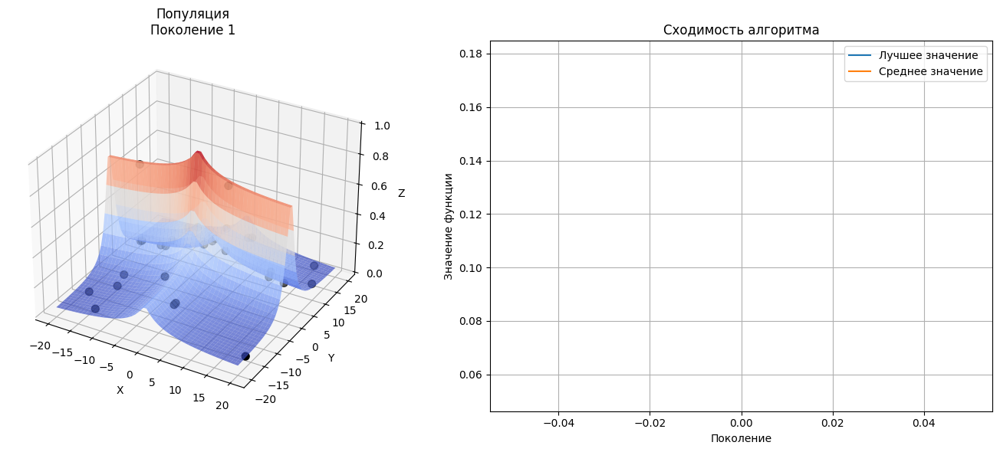

Поколение 8: Лучшее значение = 0.0515, Среднее = 0.1200


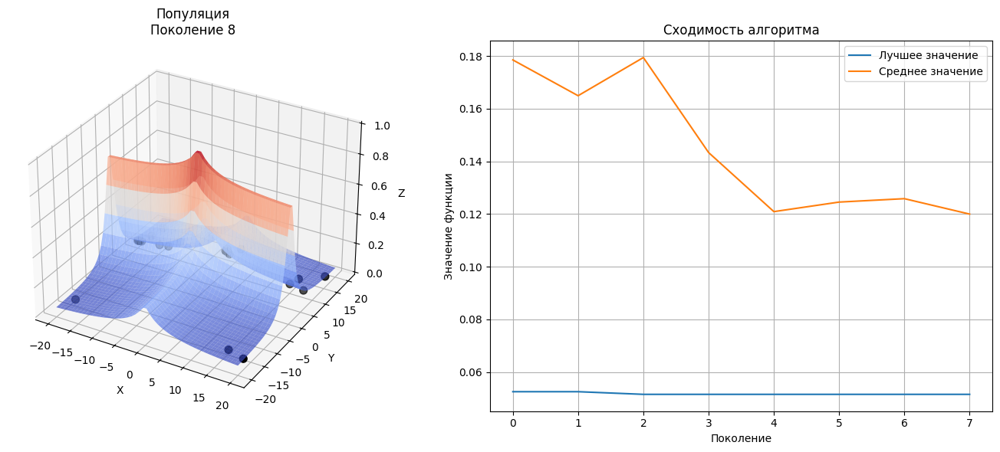

Поколение 15: Лучшее значение = 0.0512, Среднее = 0.1184


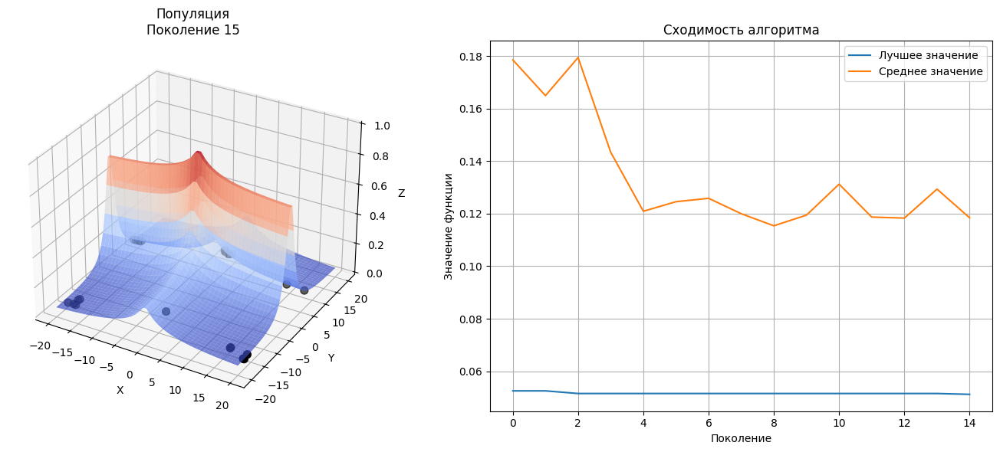

Поколение 22: Лучшее значение = 0.0511, Среднее = 0.0664


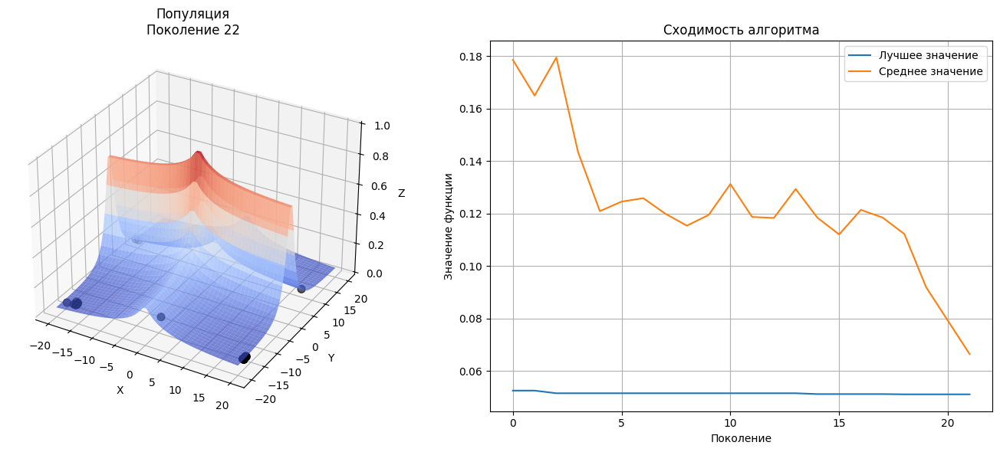

Поколение 29: Лучшее значение = 0.0504, Среднее = 0.0536


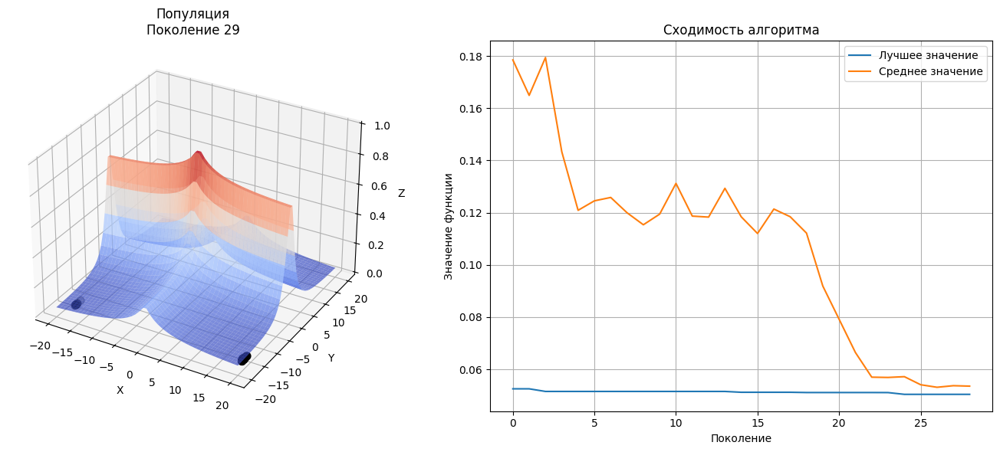

Поколение 30: Лучшее значение = 0.0504, Среднее = 0.0534


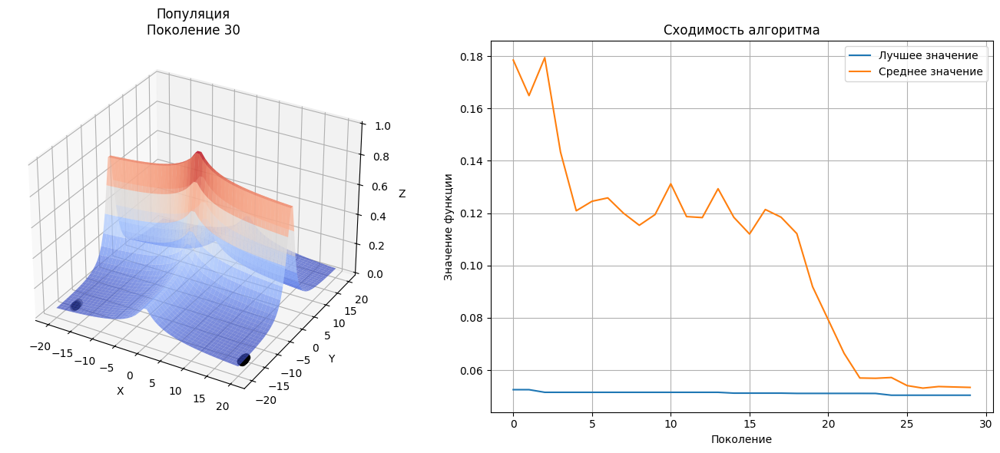


Лучшее решение: x=20.0000, y=-18.4129
Значение функции: 0.0504

МЕТОД СЕЛЕКЦИИ: tournament и МЕТОД ВЫБОРА РОДИТЕЛЕЙ: inbreeding
Поколение 1: Лучшее значение = 0.0515, Среднее = 0.2842


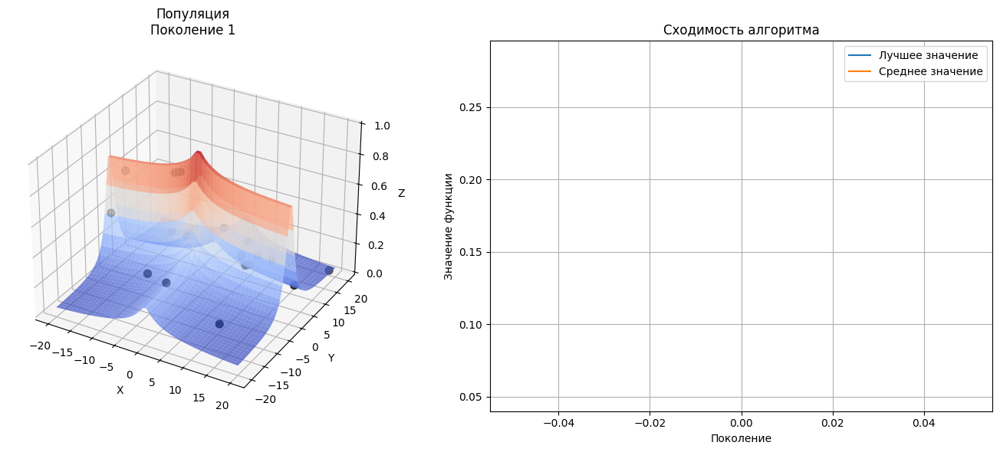

Поколение 8: Лучшее значение = 0.0509, Среднее = 0.2271


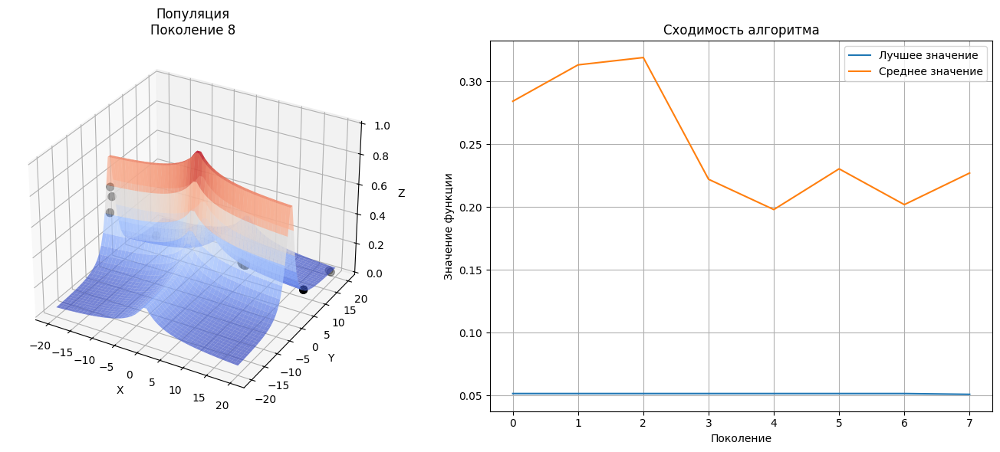

Поколение 15: Лучшее значение = 0.0505, Среднее = 0.1610


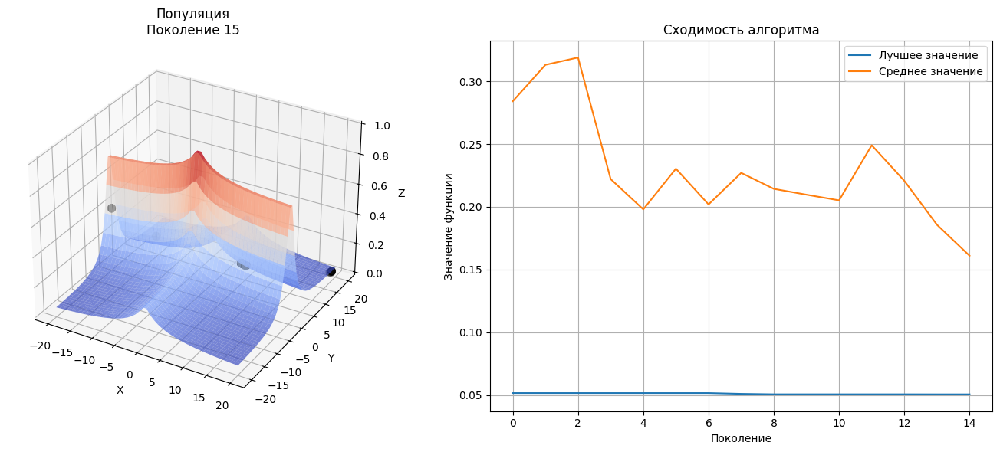

Поколение 22: Лучшее значение = 0.0500, Среднее = 0.1957


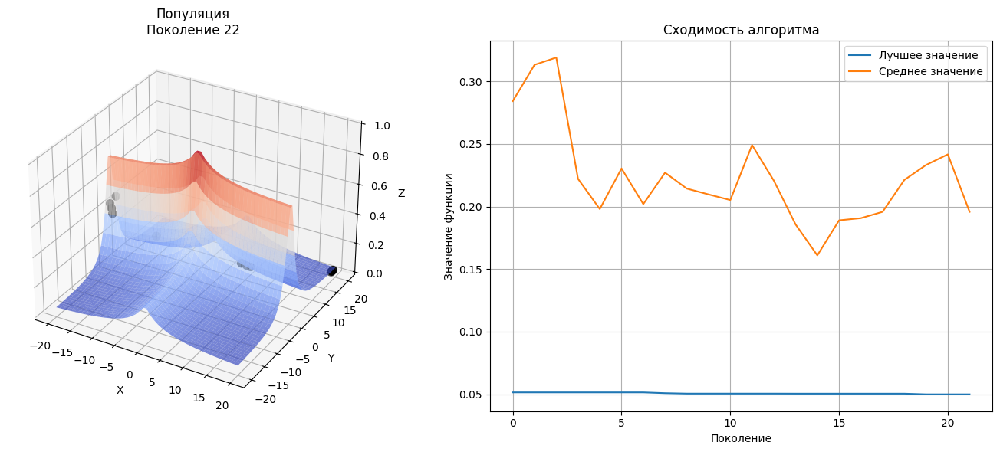

Поколение 29: Лучшее значение = 0.0497, Среднее = 0.0503


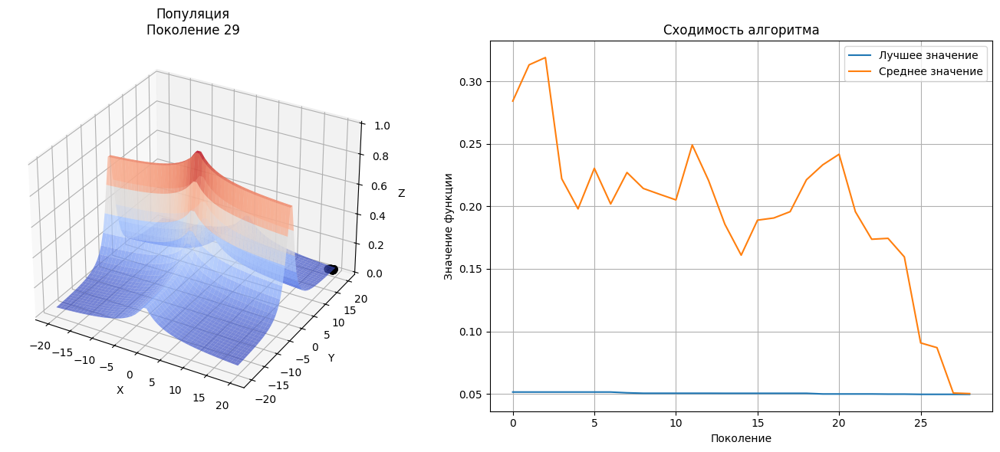

Поколение 30: Лучшее значение = 0.0497, Среднее = 0.0503


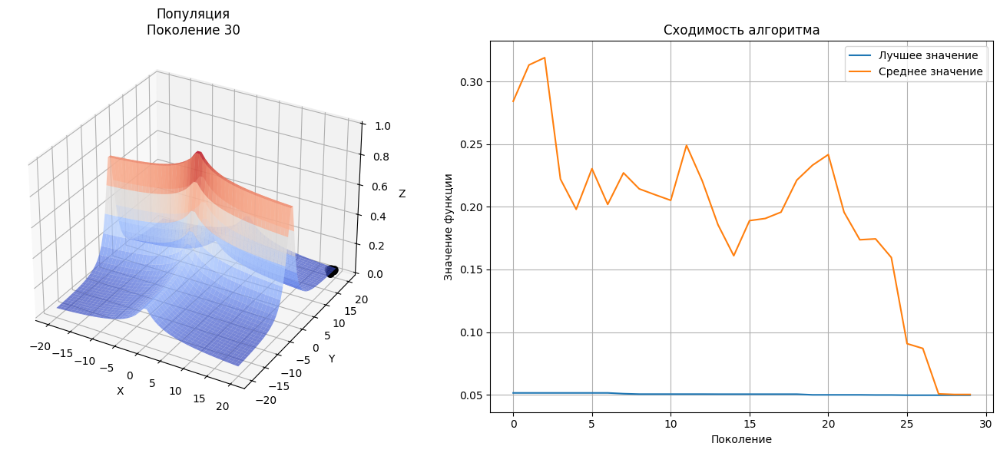


Лучшее решение: x=20.0000, y=19.2704
Значение функции: 0.0497

МЕТОД СЕЛЕКЦИИ: tournament и МЕТОД ВЫБОРА РОДИТЕЛЕЙ: outbreeding
Поколение 1: Лучшее значение = 0.0567, Среднее = 0.1586


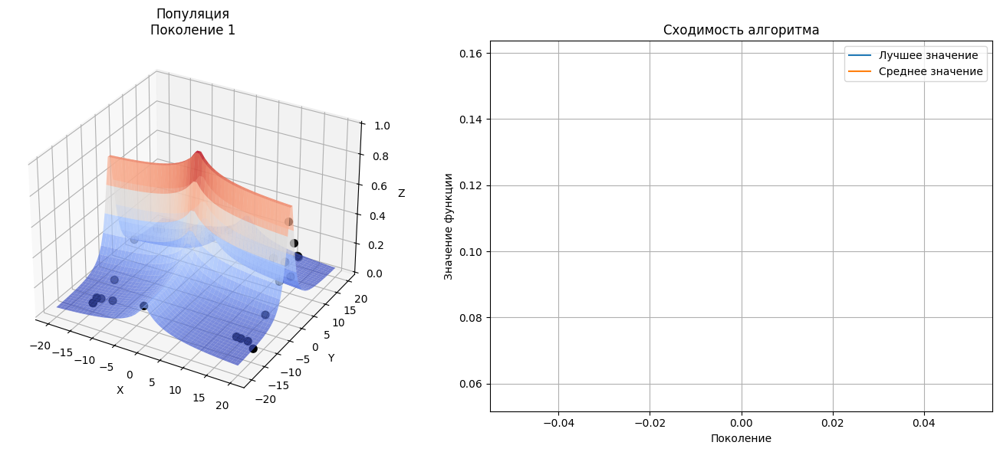

Поколение 8: Лучшее значение = 0.0498, Среднее = 0.0562


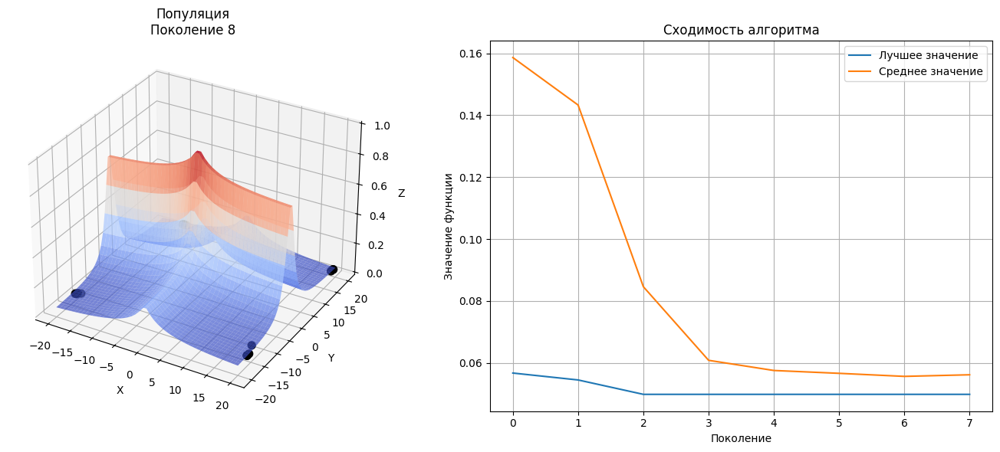

Поколение 15: Лучшее значение = 0.0491, Среднее = 0.0550


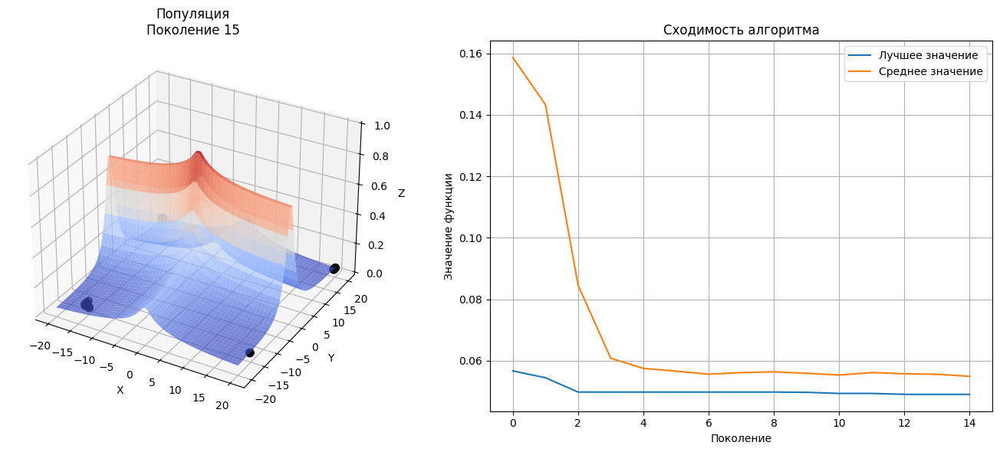

Поколение 22: Лучшее значение = 0.0491, Среднее = 0.0525


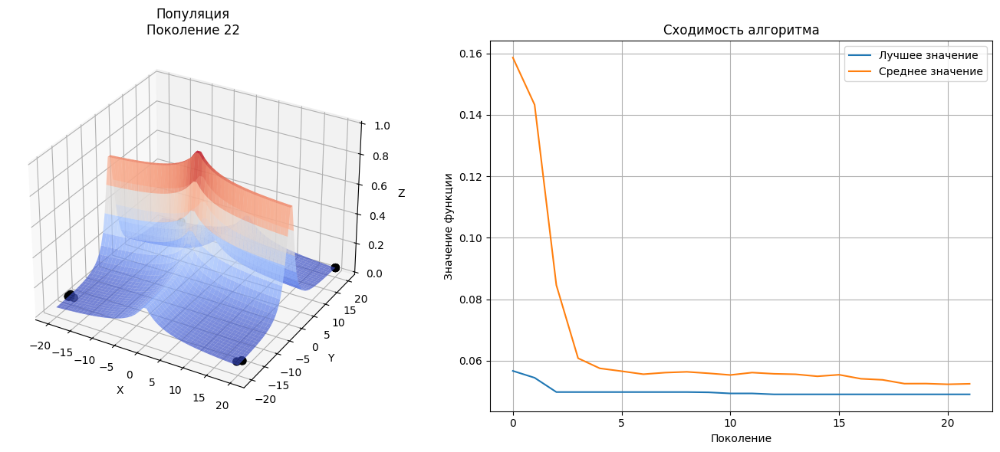

Поколение 29: Лучшее значение = 0.0491, Среднее = 0.0514


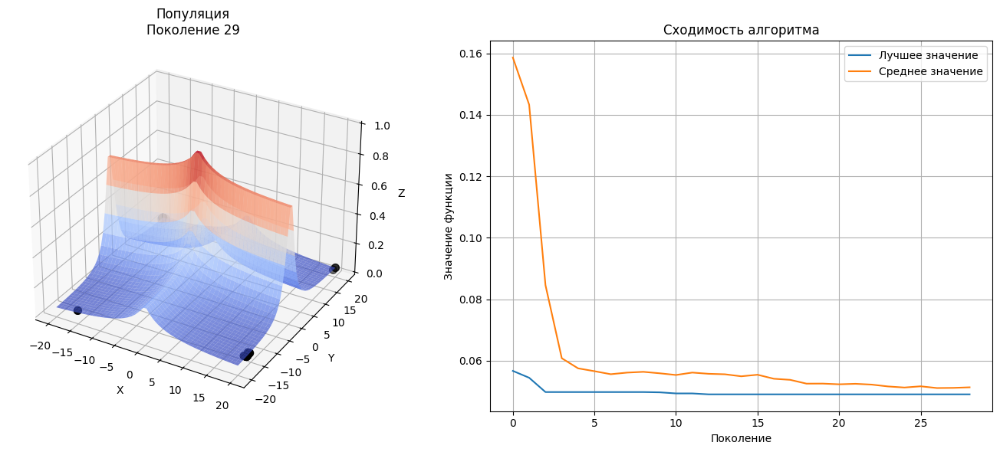

Поколение 30: Лучшее значение = 0.0491, Среднее = 0.0514


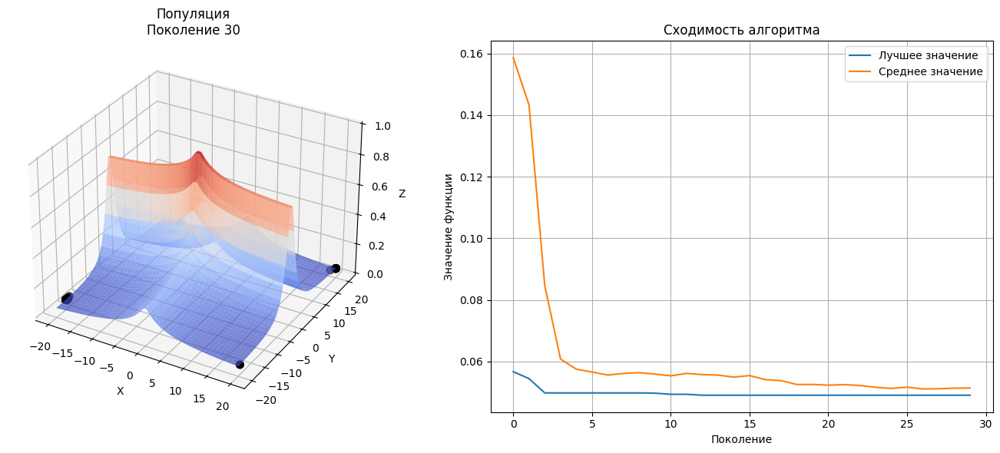


Лучшее решение: x=20.0000, y=20.0000
Значение функции: 0.0491

МЕТОД СЕЛЕКЦИИ: roulette и МЕТОД ВЫБОРА РОДИТЕЛЕЙ: panmixia
Поколение 1: Лучшее значение = 0.0552, Среднее = 0.2001


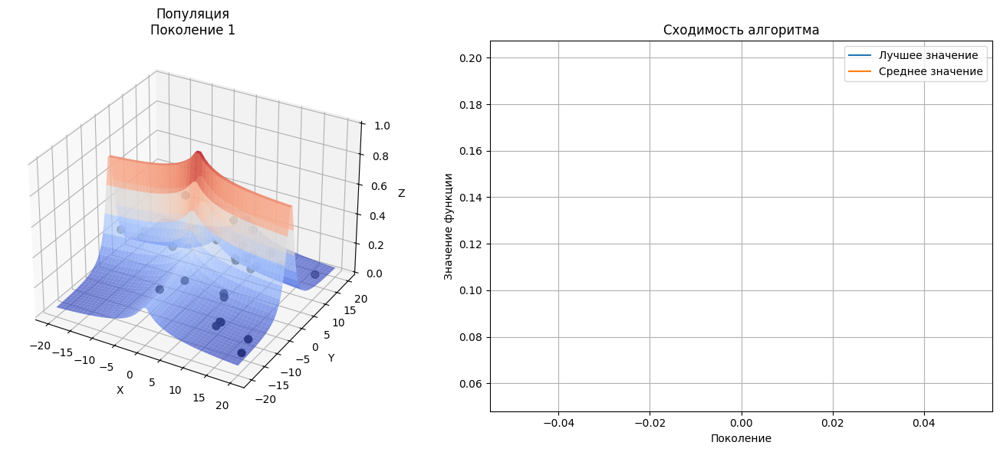

Поколение 8: Лучшее значение = 0.0529, Среднее = 0.0983


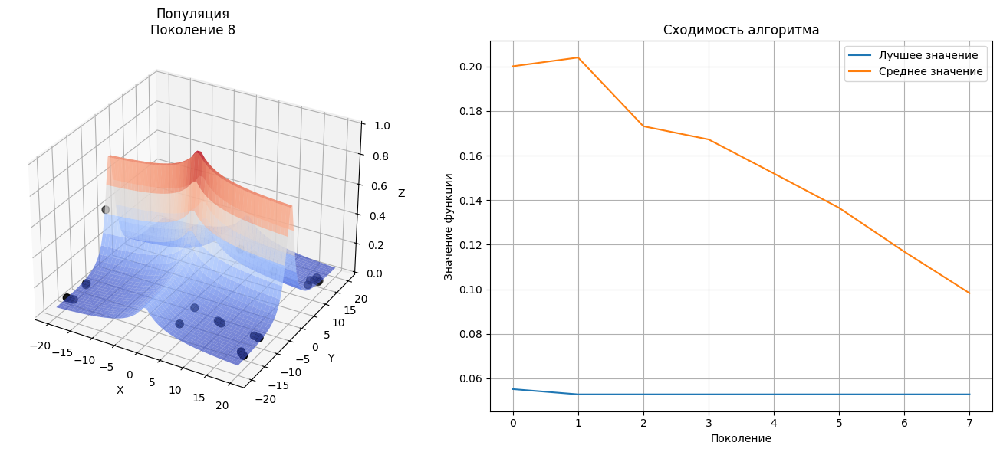

Поколение 15: Лучшее значение = 0.0529, Среднее = 0.0723


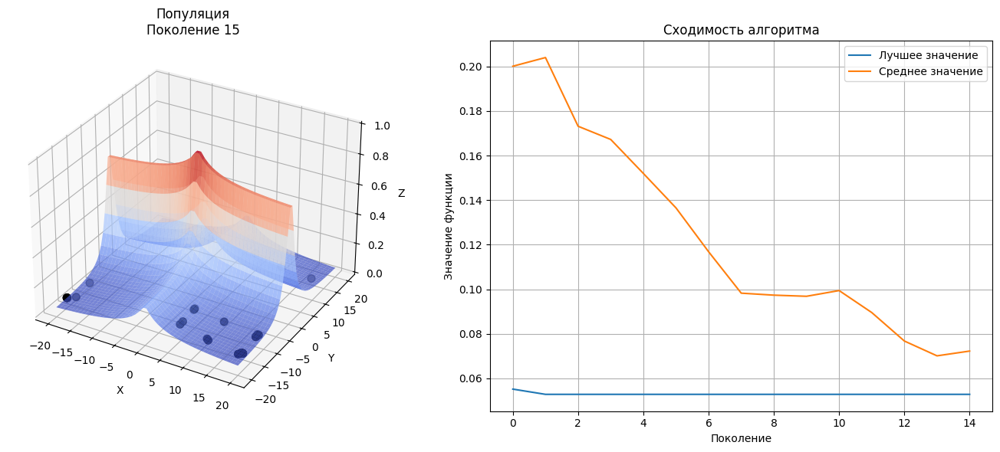

Поколение 22: Лучшее значение = 0.0524, Среднее = 0.0729


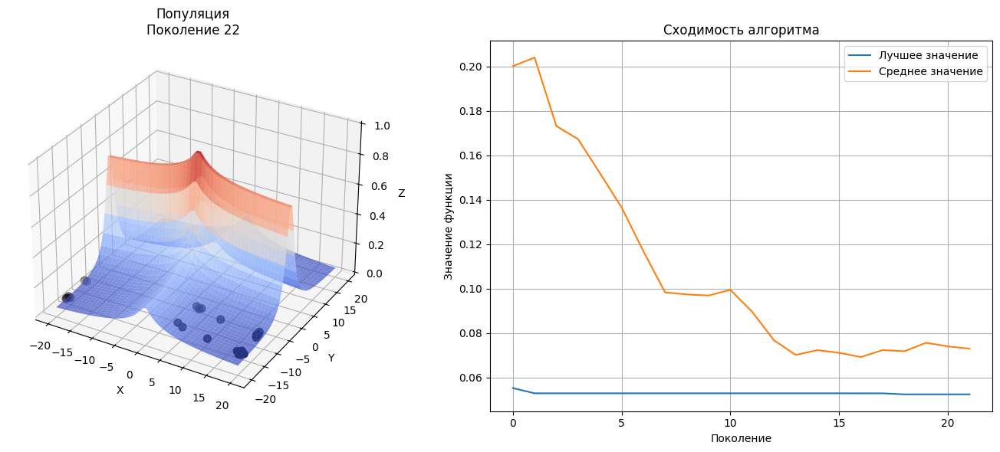

Поколение 29: Лучшее значение = 0.0521, Среднее = 0.0781


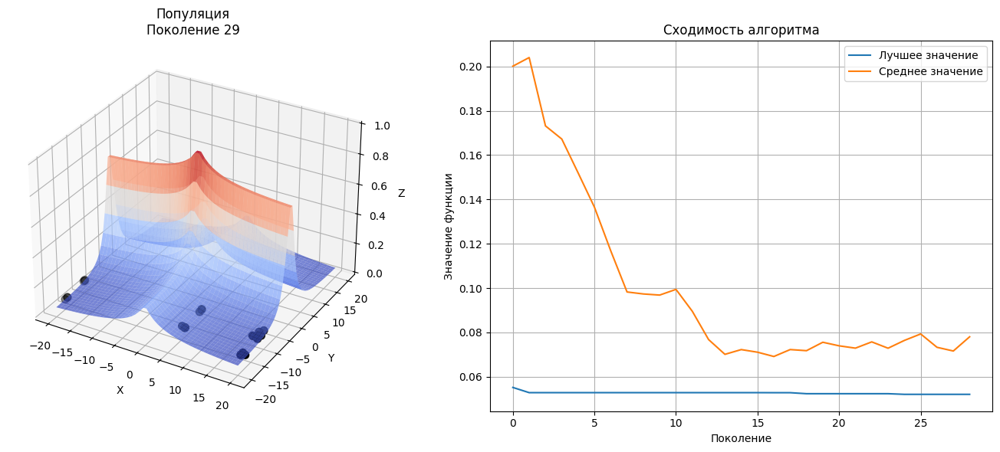

Поколение 30: Лучшее значение = 0.0521, Среднее = 0.0799


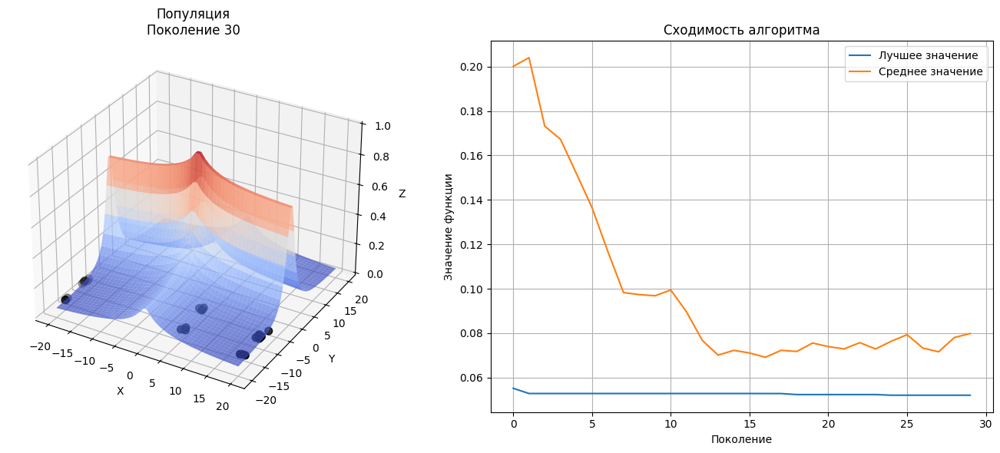


Лучшее решение: x=-20.0000, y=-16.8385
Значение функции: 0.0521

МЕТОД СЕЛЕКЦИИ: roulette и МЕТОД ВЫБОРА РОДИТЕЛЕЙ: inbreeding
Поколение 1: Лучшее значение = 0.0597, Среднее = 0.1583


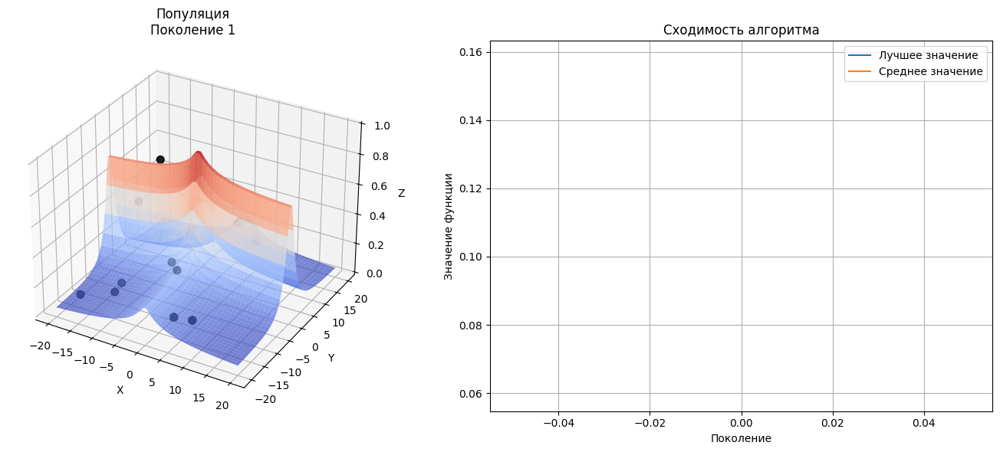

Поколение 8: Лучшее значение = 0.0597, Среднее = 0.4384


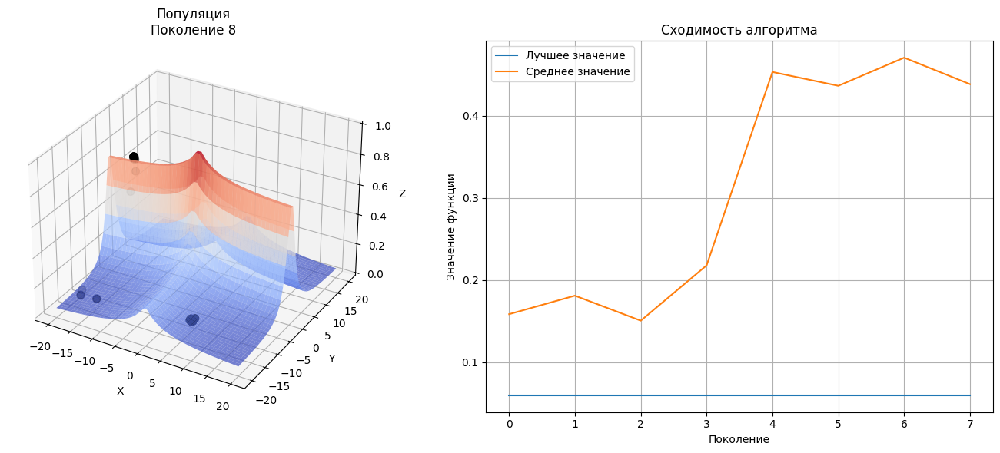

Поколение 15: Лучшее значение = 0.0586, Среднее = 0.6068


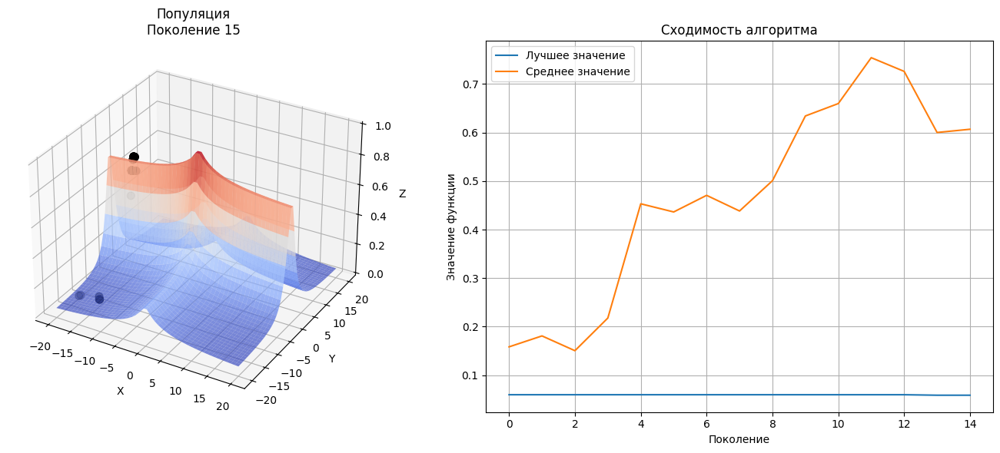

Поколение 22: Лучшее значение = 0.0571, Среднее = 0.4548


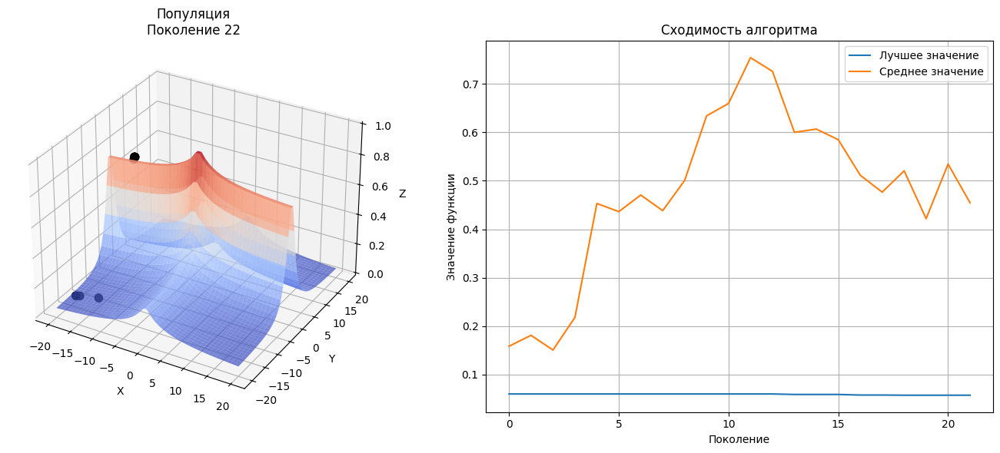

Поколение 29: Лучшее значение = 0.0552, Среднее = 0.1039


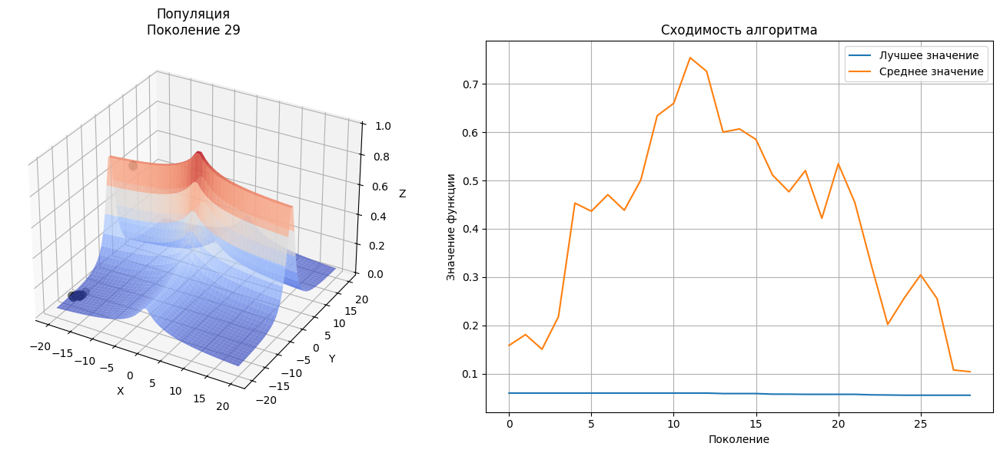

Поколение 30: Лучшее значение = 0.0552, Среднее = 0.1490


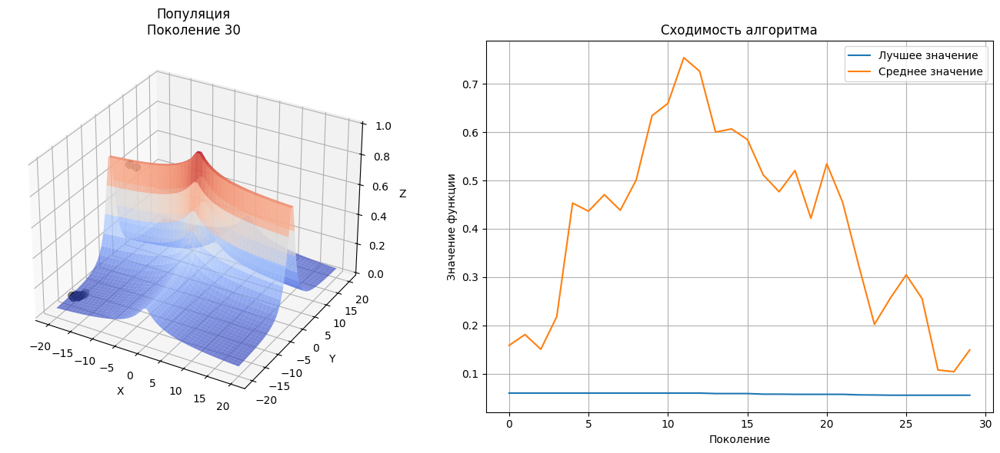


Лучшее решение: x=-19.6801, y=-15.0593
Значение функции: 0.0552

МЕТОД СЕЛЕКЦИИ: roulette и МЕТОД ВЫБОРА РОДИТЕЛЕЙ: outbreeding
Поколение 1: Лучшее значение = 0.0515, Среднее = 0.1528


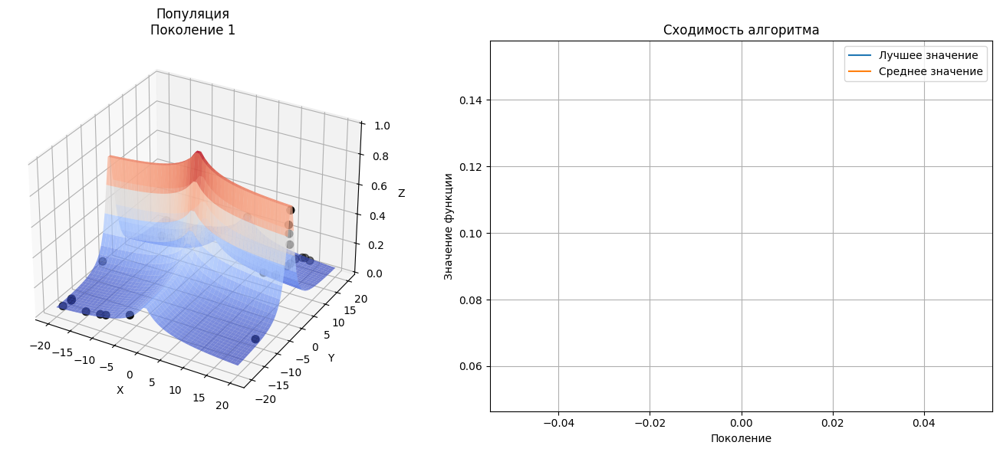

Поколение 8: Лучшее значение = 0.0491, Среднее = 0.0498


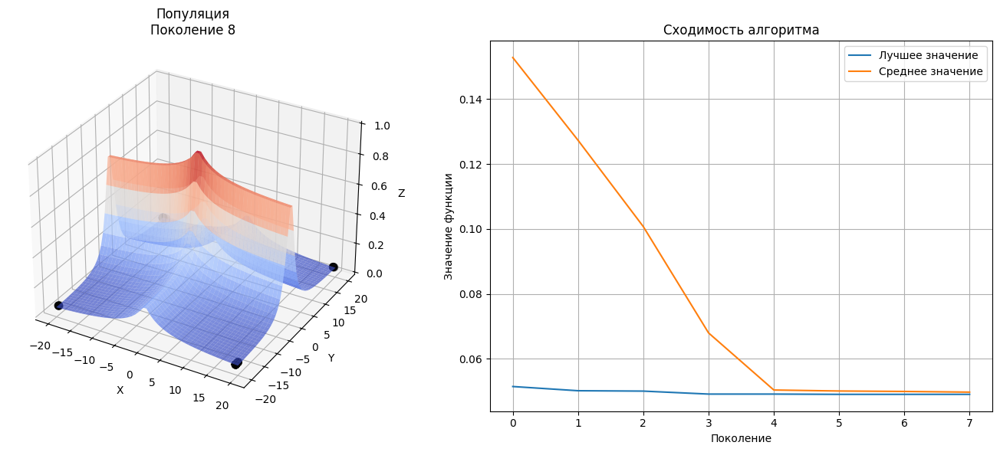

Поколение 15: Лучшее значение = 0.0491, Среднее = 0.0494


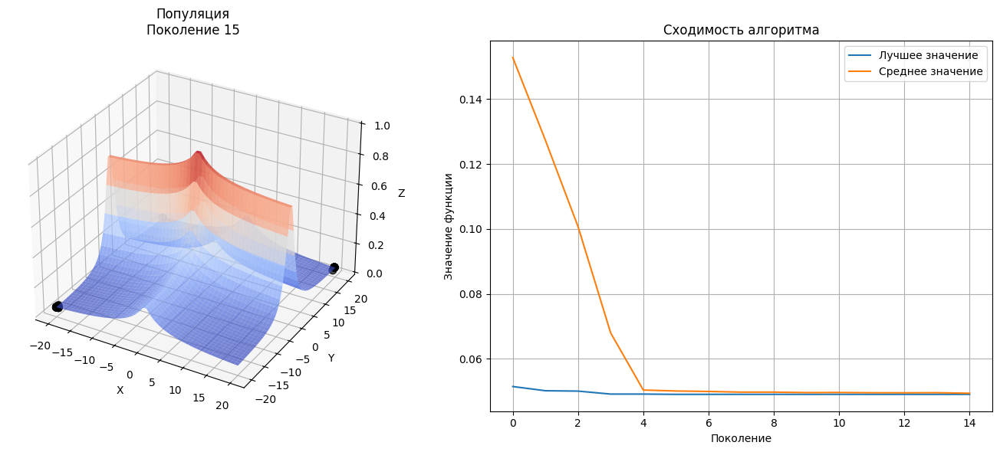

Поколение 22: Лучшее значение = 0.0491, Среднее = 0.0491


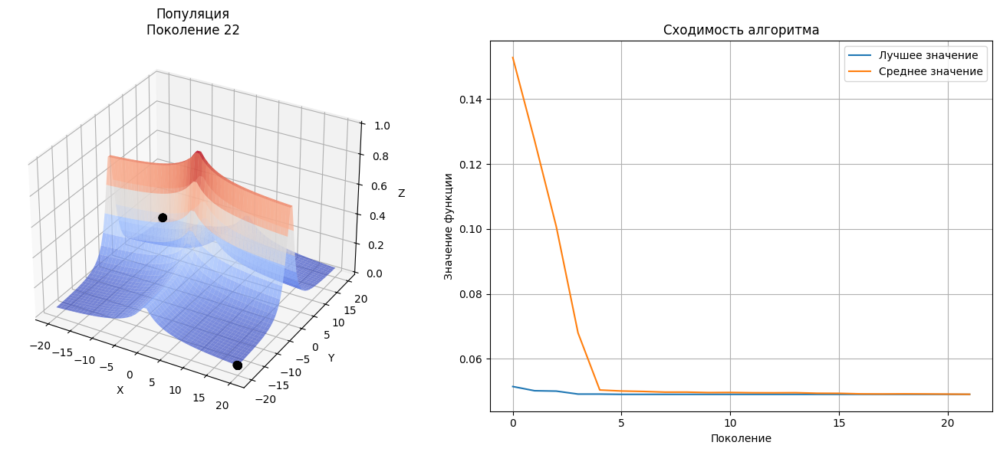

Поколение 29: Лучшее значение = 0.0491, Среднее = 0.0493


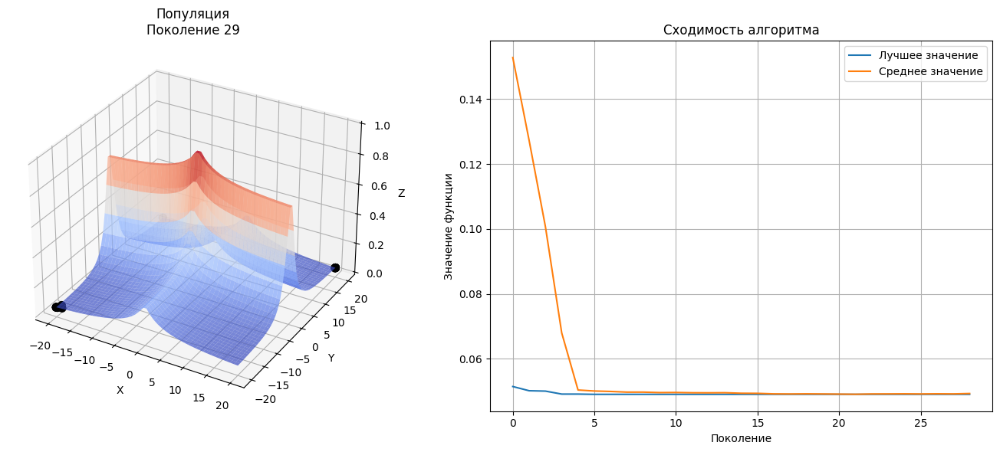

Поколение 30: Лучшее значение = 0.0491, Среднее = 0.0492


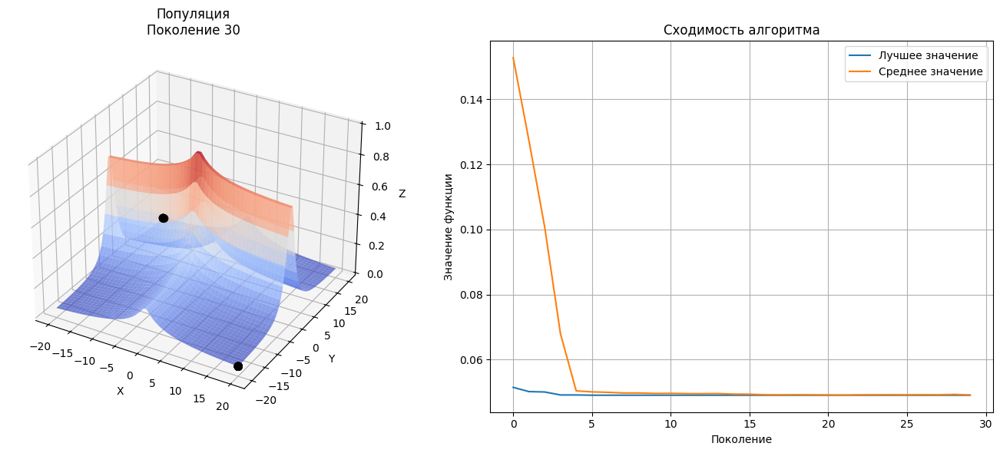


Лучшее решение: x=-20.0000, y=20.0000
Значение функции: 0.0491

МЕТОД СЕЛЕКЦИИ: ranking и МЕТОД ВЫБОРА РОДИТЕЛЕЙ: panmixia
Поколение 1: Лучшее значение = 0.0505, Среднее = 0.2377


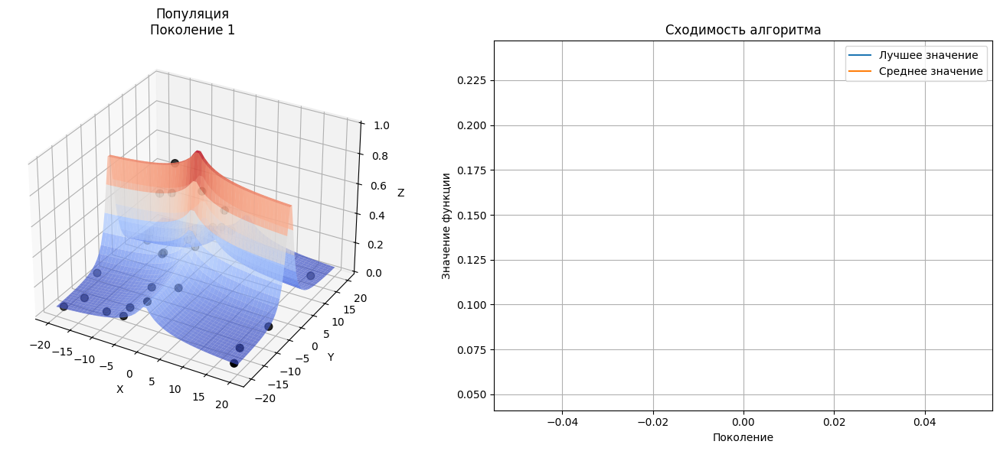

Поколение 8: Лучшее значение = 0.0505, Среднее = 0.3328


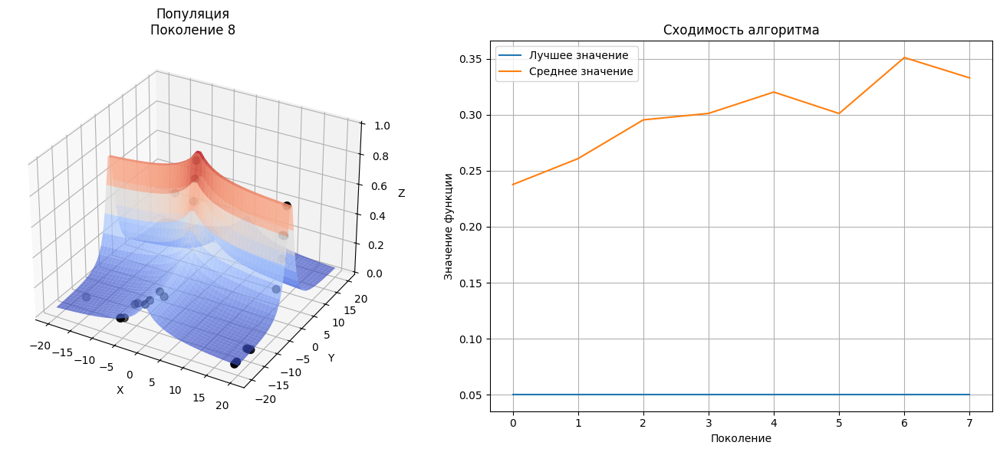

Поколение 15: Лучшее значение = 0.0500, Среднее = 0.3617


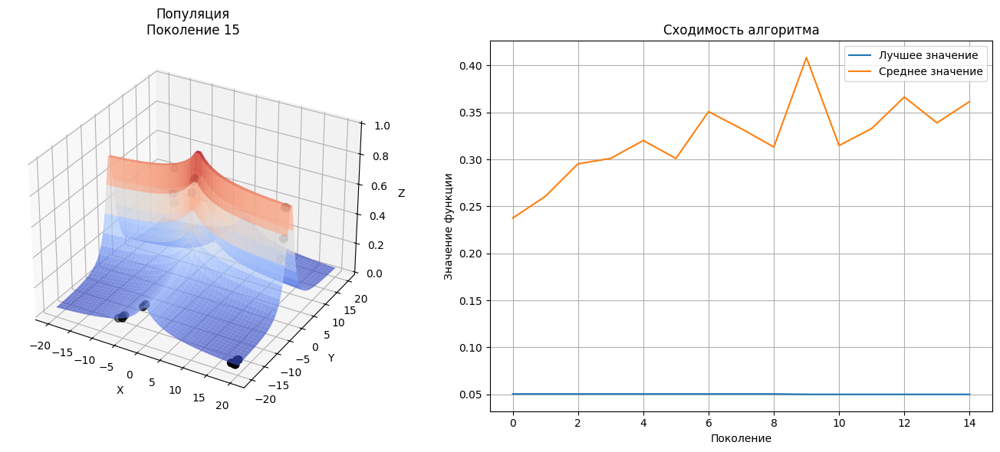

Поколение 22: Лучшее значение = 0.0491, Среднее = 0.1894


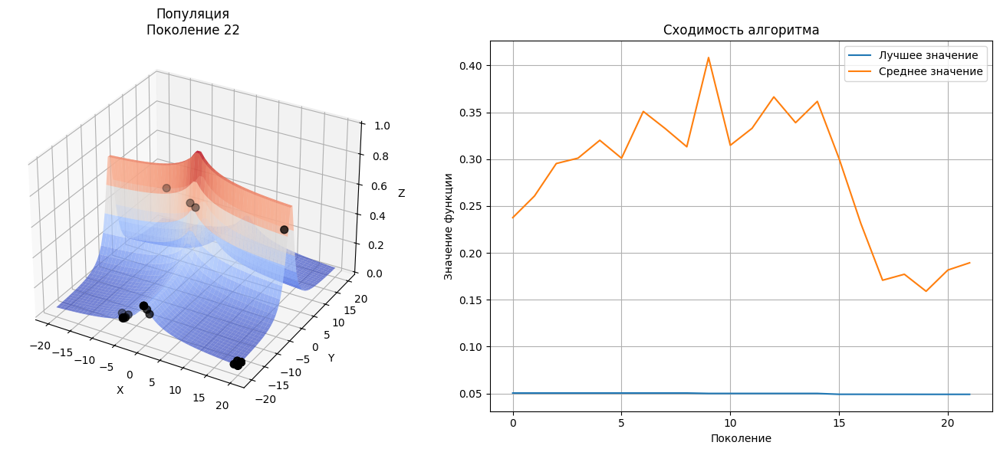

Поколение 29: Лучшее значение = 0.0491, Среднее = 0.0776


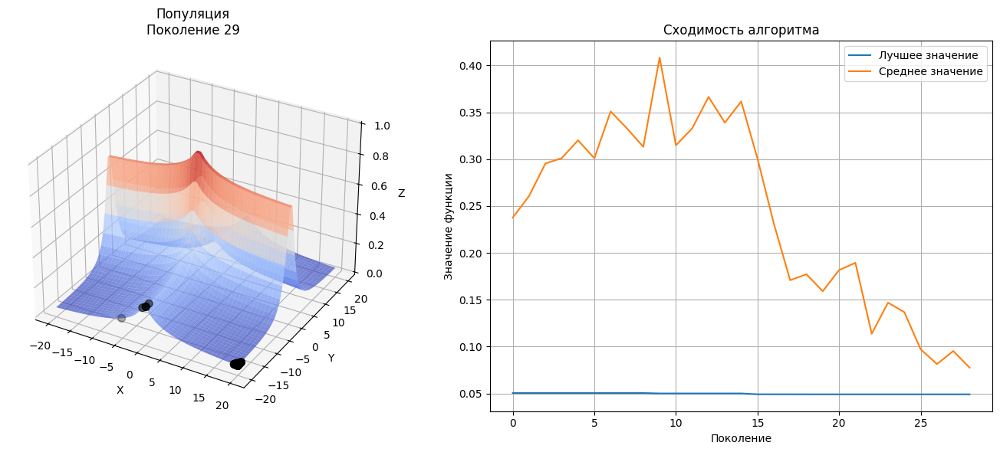

Поколение 30: Лучшее значение = 0.0491, Среднее = 0.0688


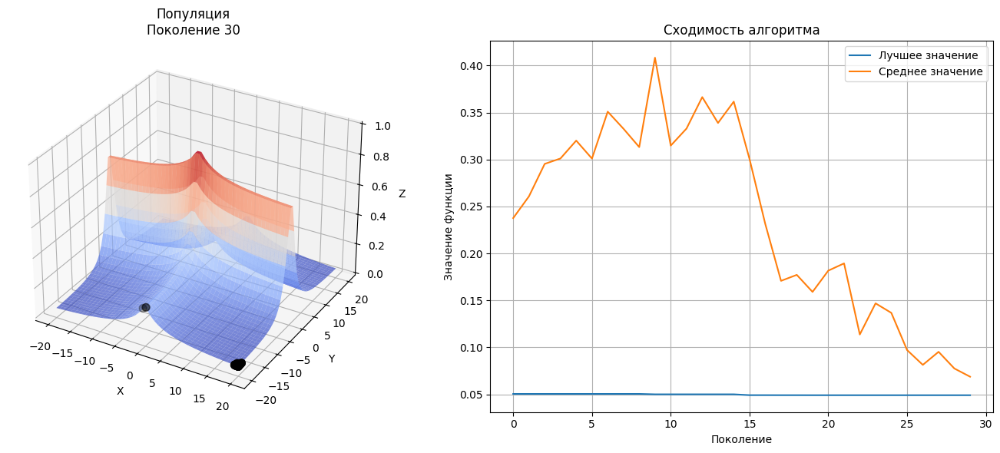


Лучшее решение: x=20.0000, y=-20.0000
Значение функции: 0.0491

МЕТОД СЕЛЕКЦИИ: ranking и МЕТОД ВЫБОРА РОДИТЕЛЕЙ: inbreeding
Поколение 1: Лучшее значение = 0.0531, Среднее = 0.1282


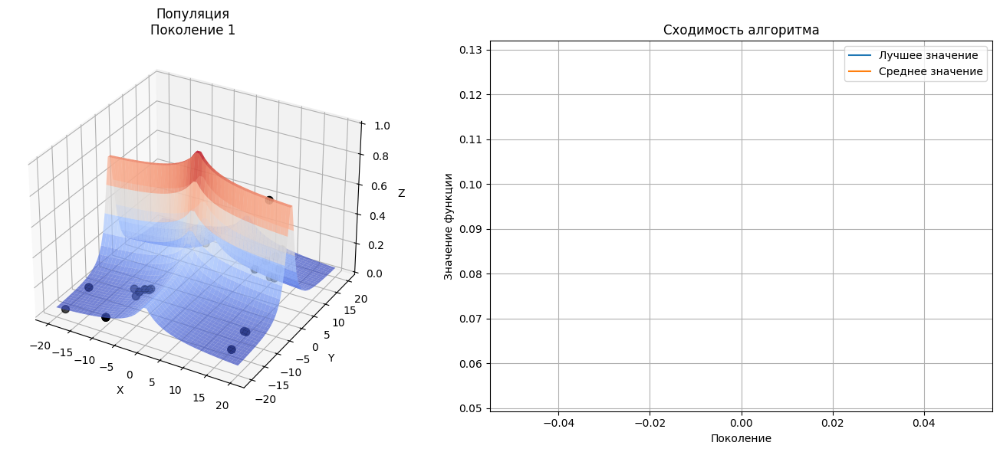

Поколение 8: Лучшее значение = 0.0518, Среднее = 0.1349


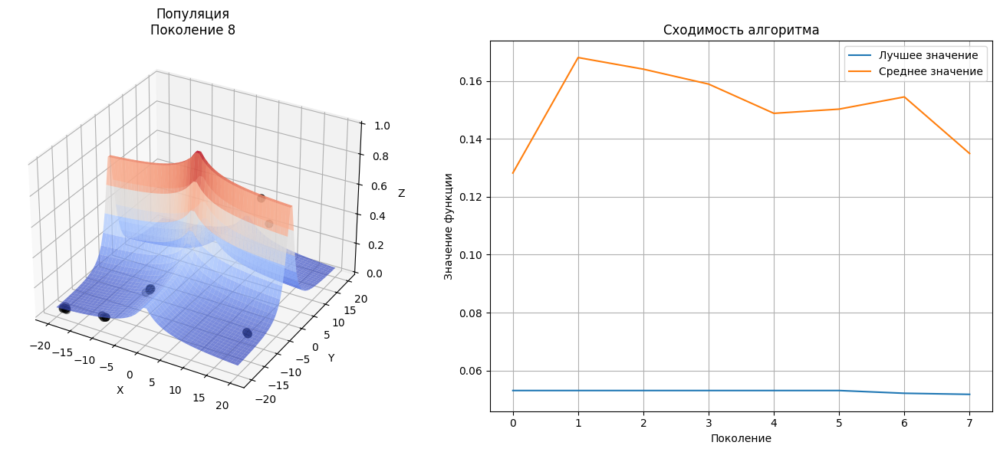

Поколение 15: Лучшее значение = 0.0513, Среднее = 0.1121


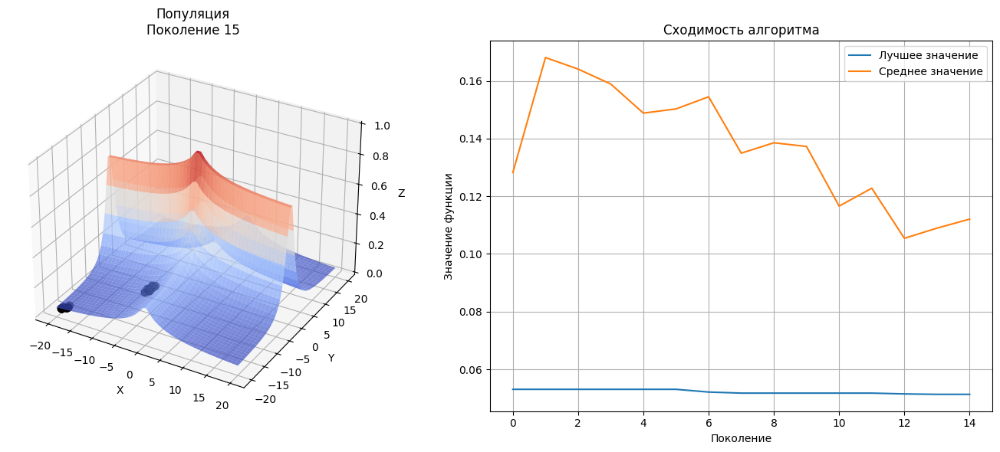

Поколение 22: Лучшее значение = 0.0495, Среднее = 0.0879


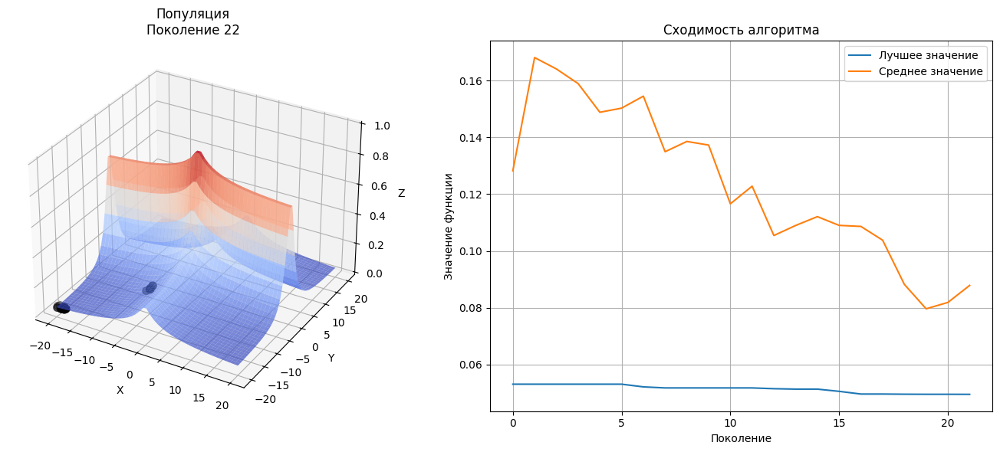

Поколение 29: Лучшее значение = 0.0491, Среднее = 0.0565


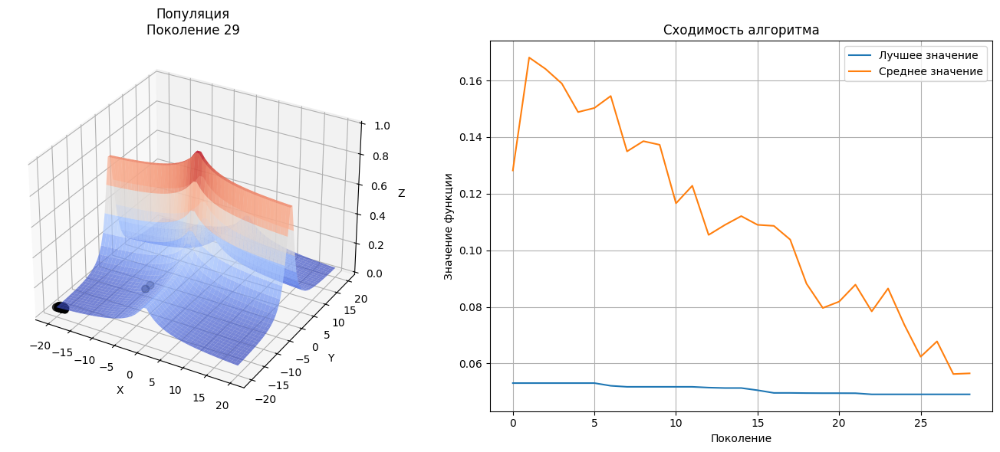

Поколение 30: Лучшее значение = 0.0491, Среднее = 0.0507


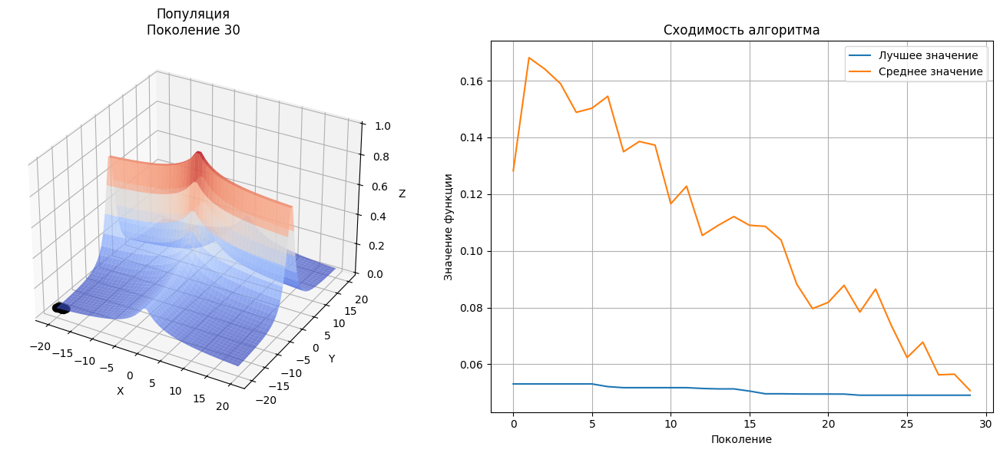


Лучшее решение: x=-20.0000, y=-20.0000
Значение функции: 0.0491

МЕТОД СЕЛЕКЦИИ: ranking и МЕТОД ВЫБОРА РОДИТЕЛЕЙ: outbreeding
Поколение 1: Лучшее значение = 0.0530, Среднее = 0.1443


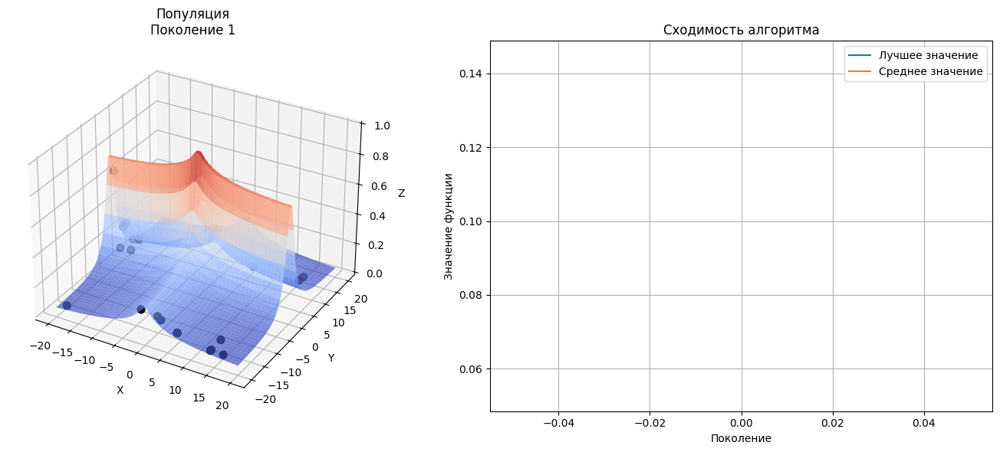

Поколение 8: Лучшее значение = 0.0500, Среднее = 0.0531


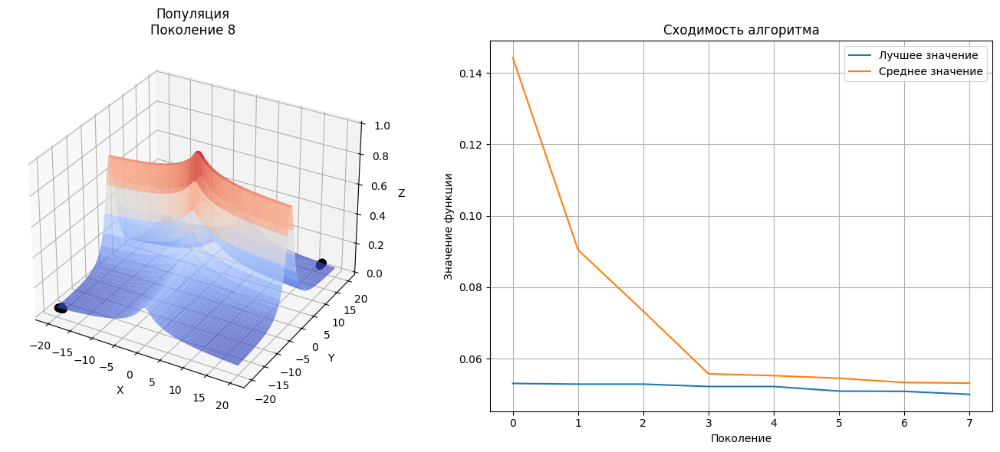

Поколение 15: Лучшее значение = 0.0491, Среднее = 0.0506


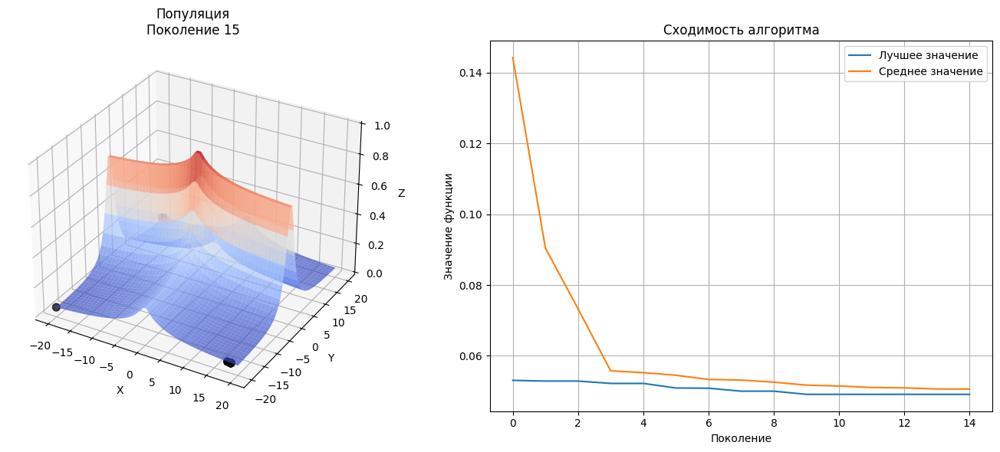

Поколение 22: Лучшее значение = 0.0491, Среднее = 0.0499


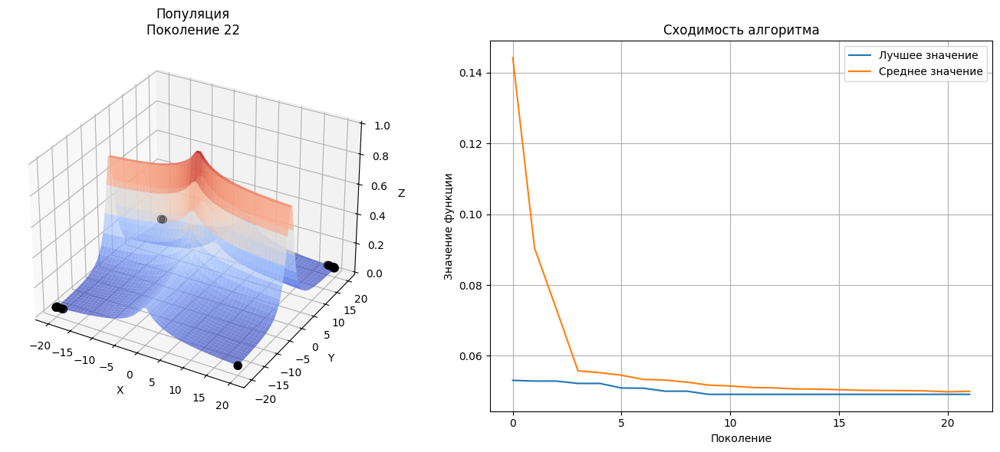

Поколение 29: Лучшее значение = 0.0491, Среднее = 0.0492


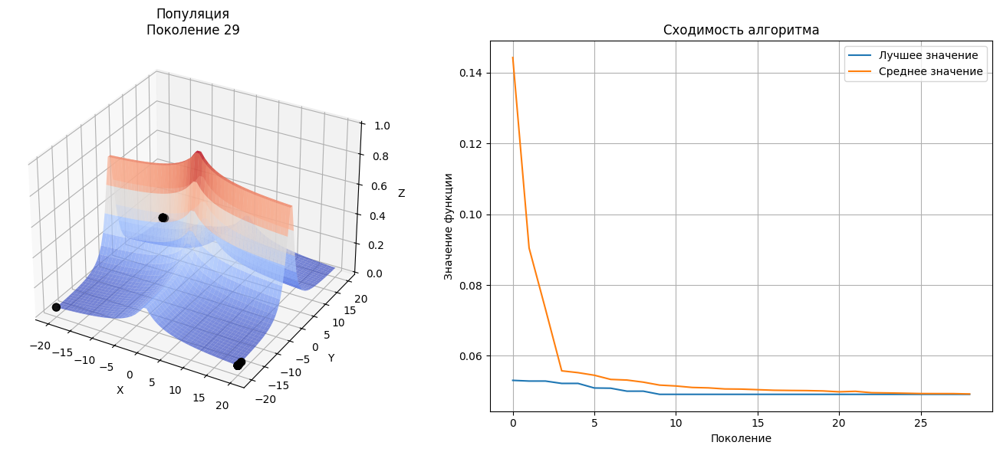

Поколение 30: Лучшее значение = 0.0491, Среднее = 0.0493


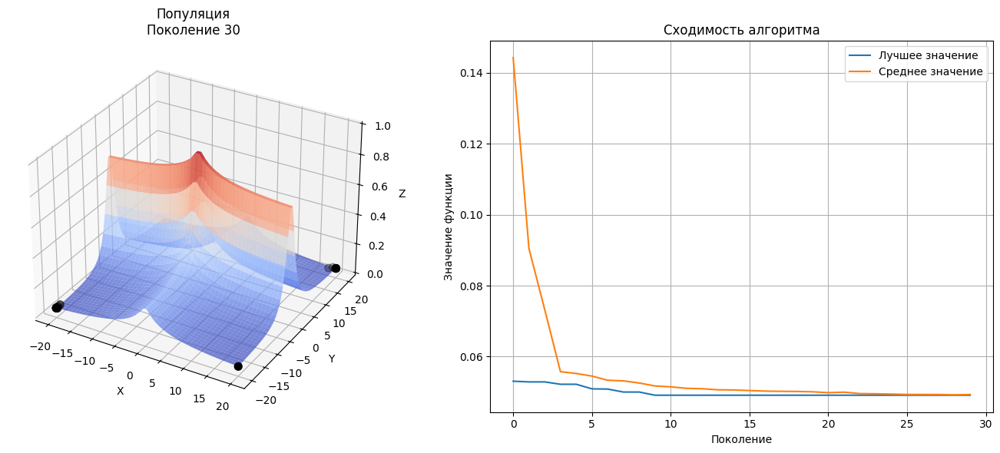


Лучшее решение: x=-20.0000, y=-20.0000
Значение функции: 0.0491

МЕТОД СЕЛЕКЦИИ: uniform_ranking и МЕТОД ВЫБОРА РОДИТЕЛЕЙ: panmixia
Поколение 1: Лучшее значение = 0.0588, Среднее = 0.2644


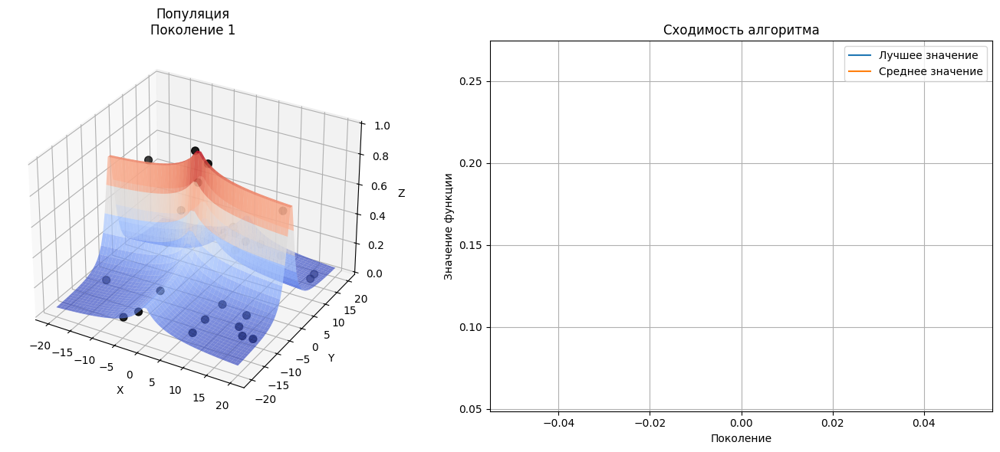

Поколение 8: Лучшее значение = 0.0523, Среднее = 0.3760


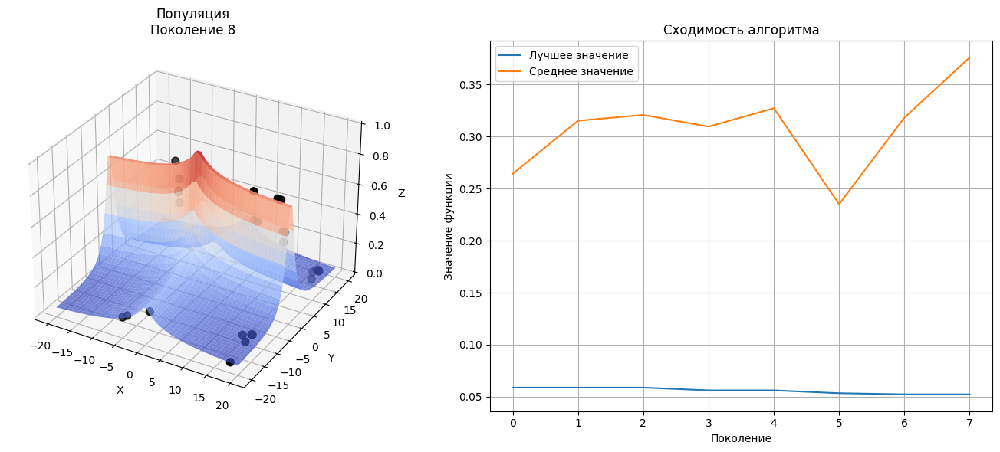

Поколение 15: Лучшее значение = 0.0517, Среднее = 0.1869


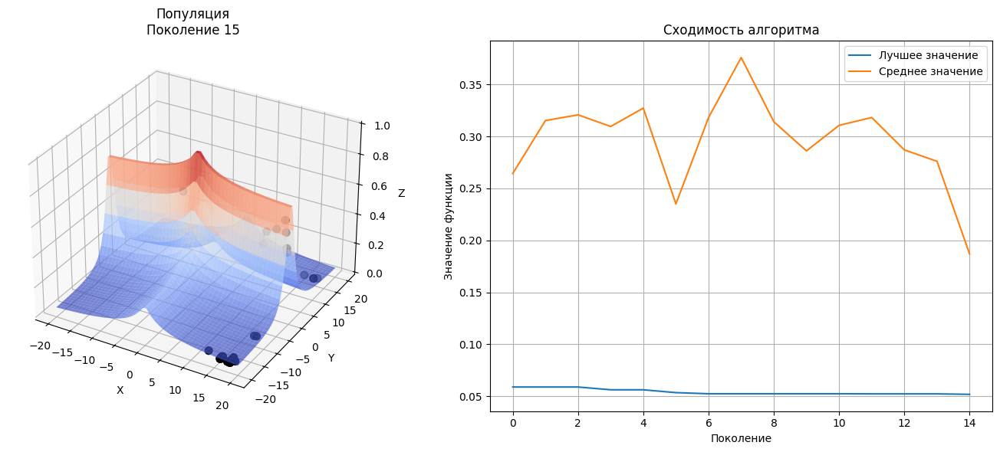

Поколение 22: Лучшее значение = 0.0499, Среднее = 0.1995


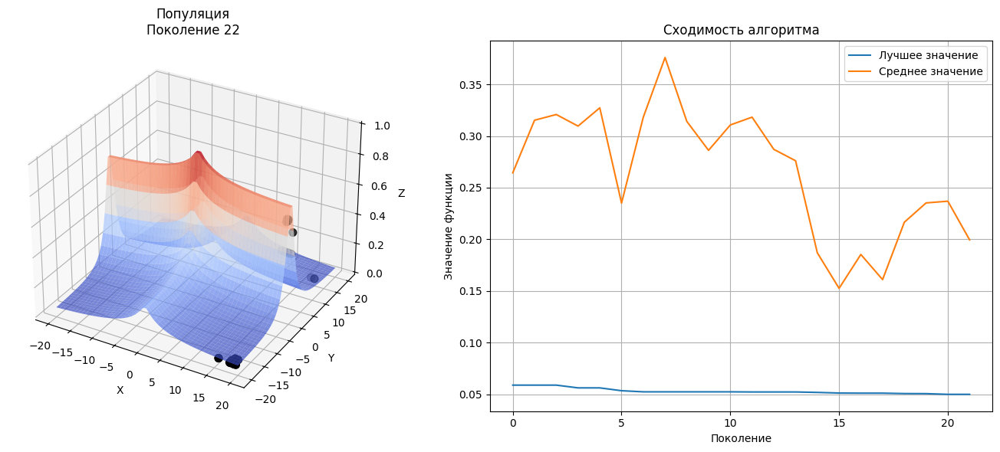

Поколение 29: Лучшее значение = 0.0491, Среднее = 0.1899


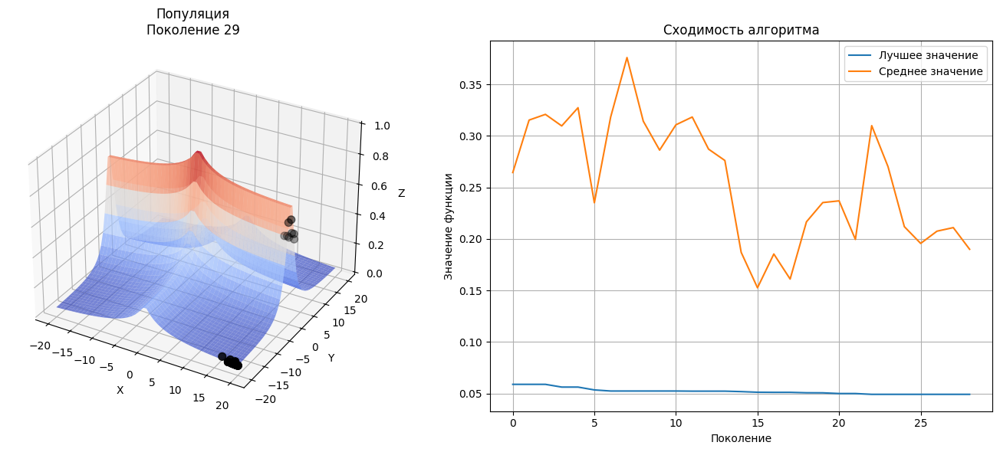

Поколение 30: Лучшее значение = 0.0491, Среднее = 0.2090


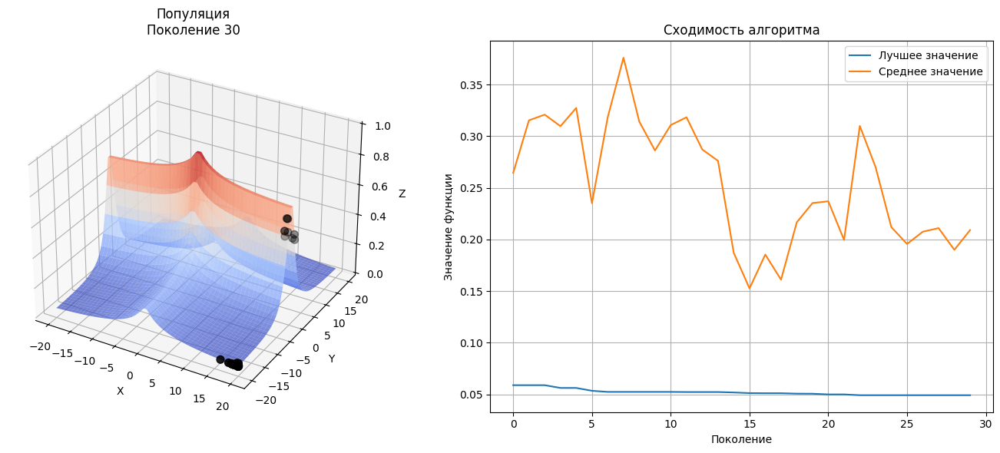


Лучшее решение: x=20.0000, y=-20.0000
Значение функции: 0.0491

МЕТОД СЕЛЕКЦИИ: uniform_ranking и МЕТОД ВЫБОРА РОДИТЕЛЕЙ: inbreeding
Поколение 1: Лучшее значение = 0.0534, Среднее = 0.1548


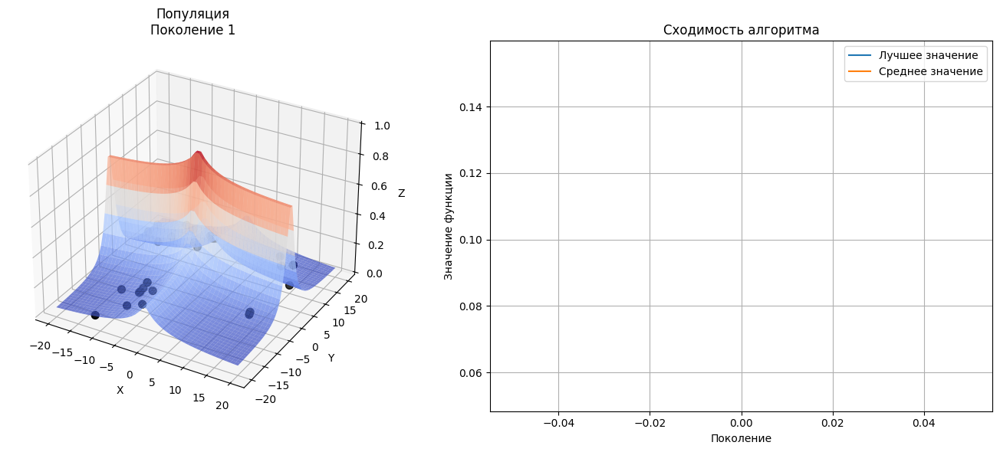

Поколение 8: Лучшее значение = 0.0526, Среднее = 0.1476


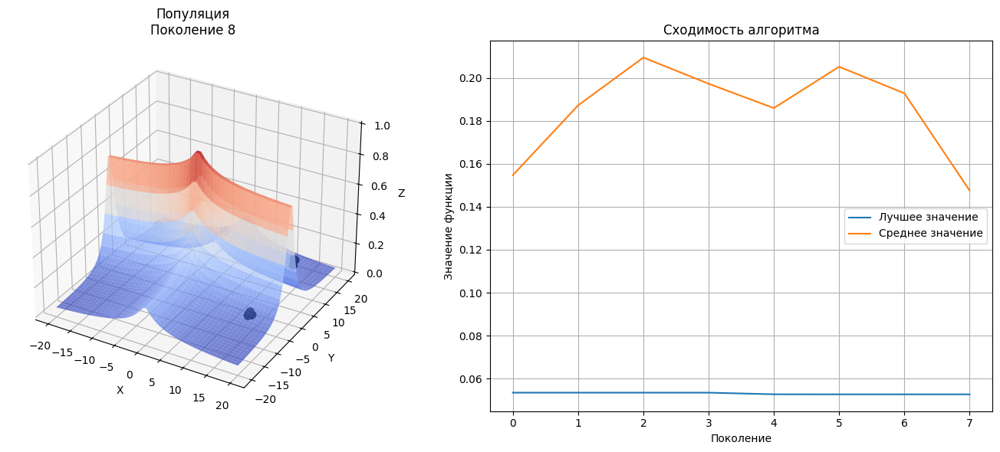

Поколение 15: Лучшее значение = 0.0510, Среднее = 0.0911


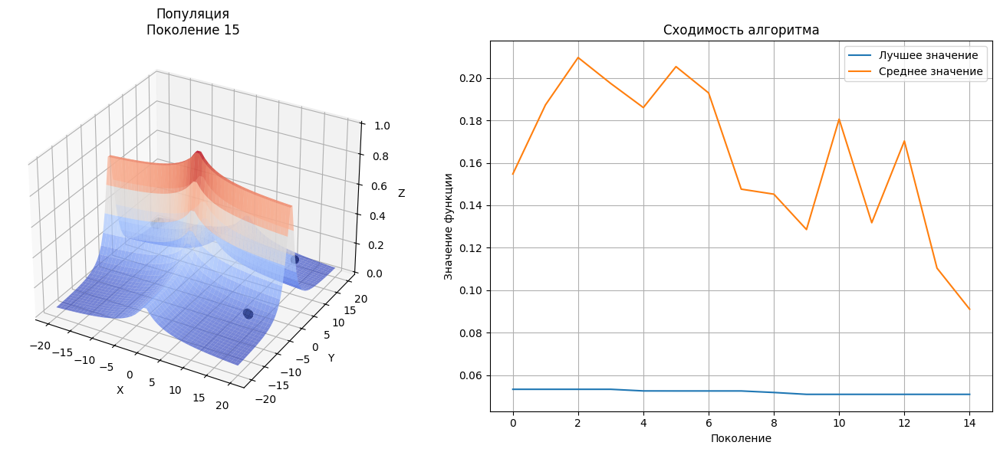

Поколение 22: Лучшее значение = 0.0503, Среднее = 0.0765


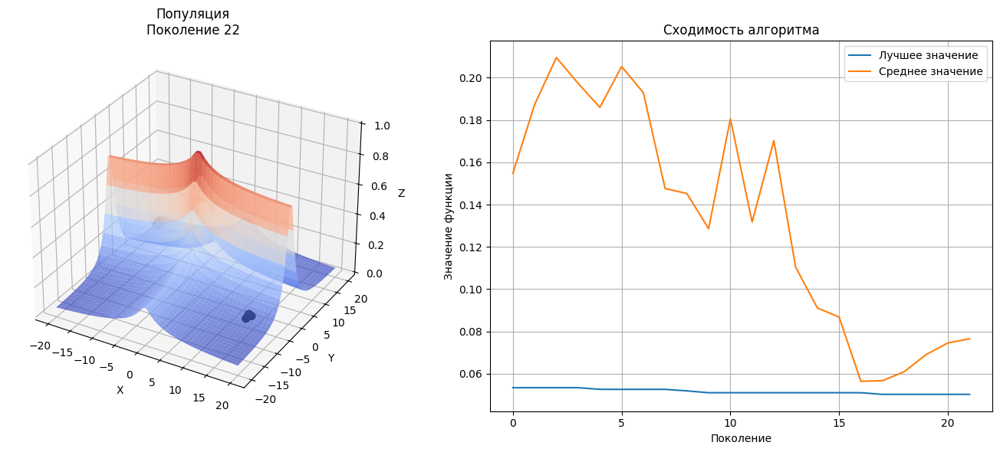

Поколение 29: Лучшее значение = 0.0502, Среднее = 0.0695


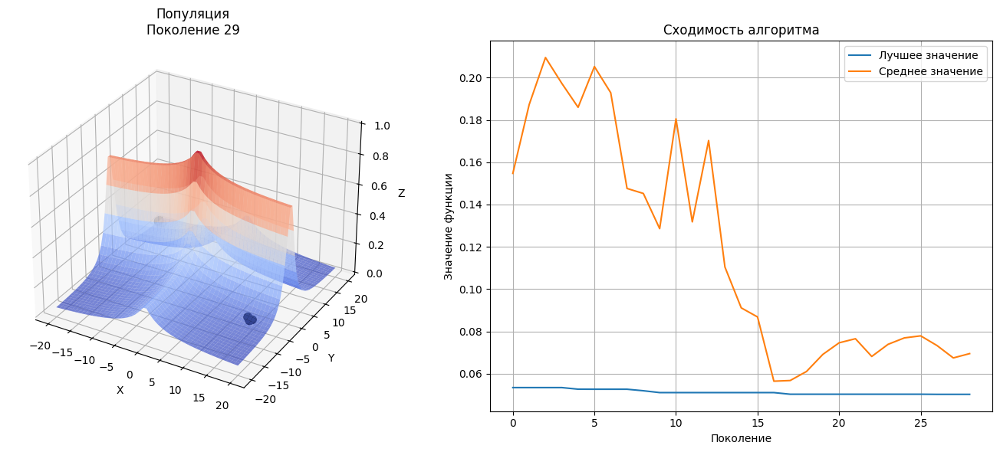

Поколение 30: Лучшее значение = 0.0500, Среднее = 0.0695


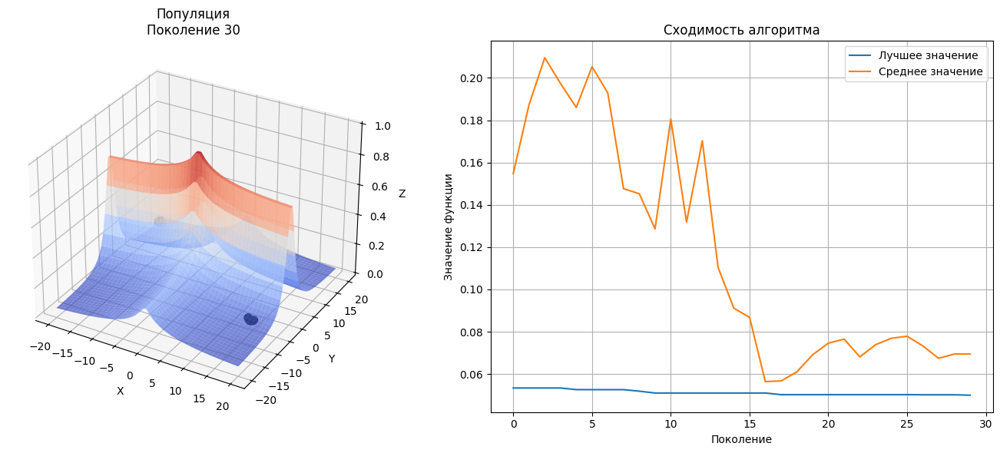


Лучшее решение: x=-20.0000, y=18.8792
Значение функции: 0.0500

МЕТОД СЕЛЕКЦИИ: uniform_ranking и МЕТОД ВЫБОРА РОДИТЕЛЕЙ: outbreeding
Поколение 1: Лучшее значение = 0.0510, Среднее = 0.1109


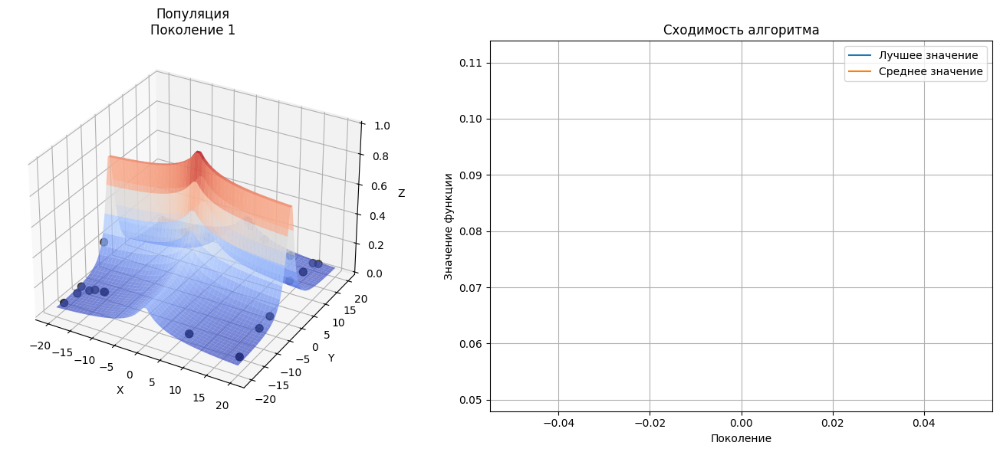

Поколение 8: Лучшее значение = 0.0491, Среднее = 0.0526


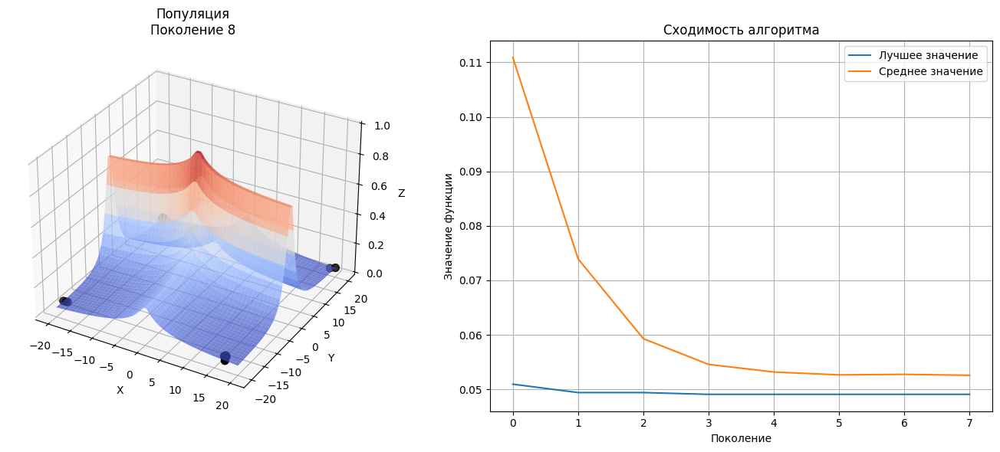

Поколение 15: Лучшее значение = 0.0491, Среднее = 0.0507


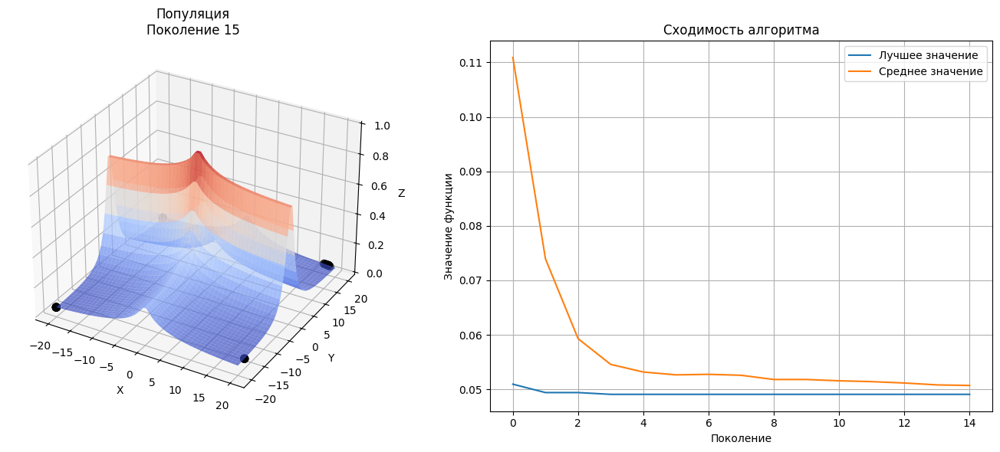

Поколение 22: Лучшее значение = 0.0491, Среднее = 0.0507


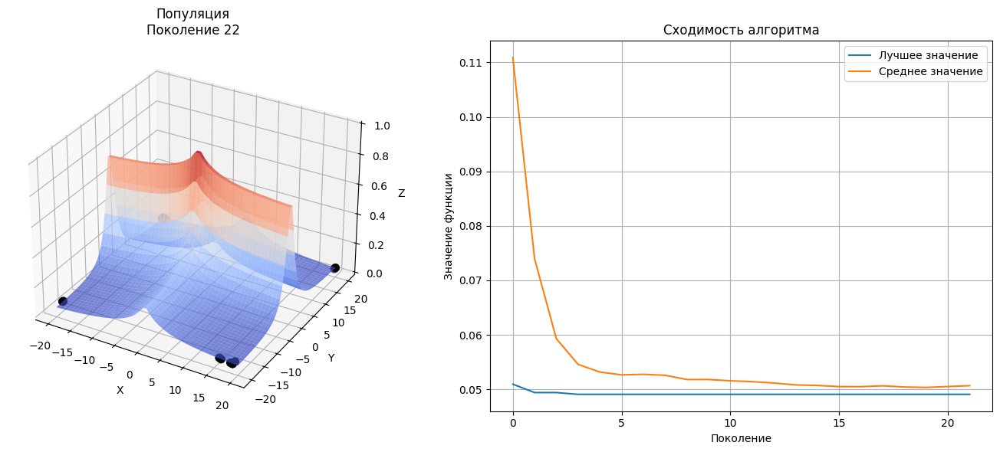

Поколение 29: Лучшее значение = 0.0491, Среднее = 0.0494


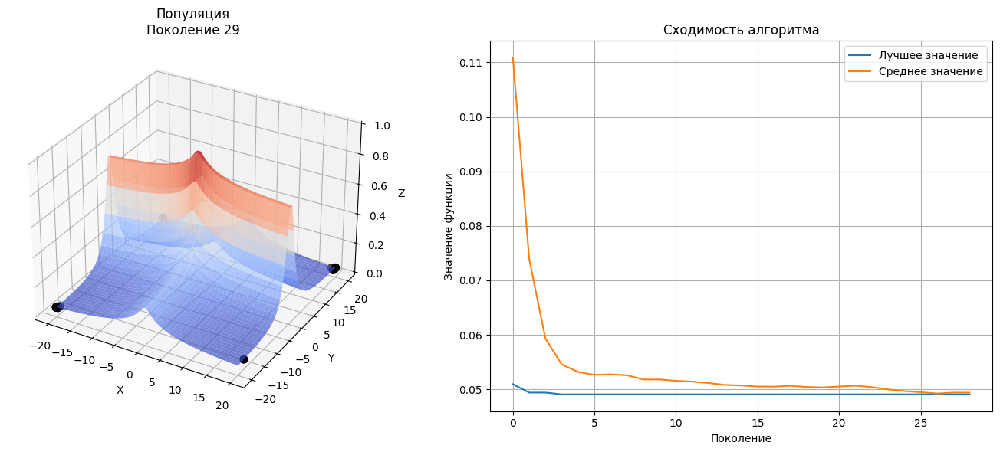

Поколение 30: Лучшее значение = 0.0491, Среднее = 0.0495


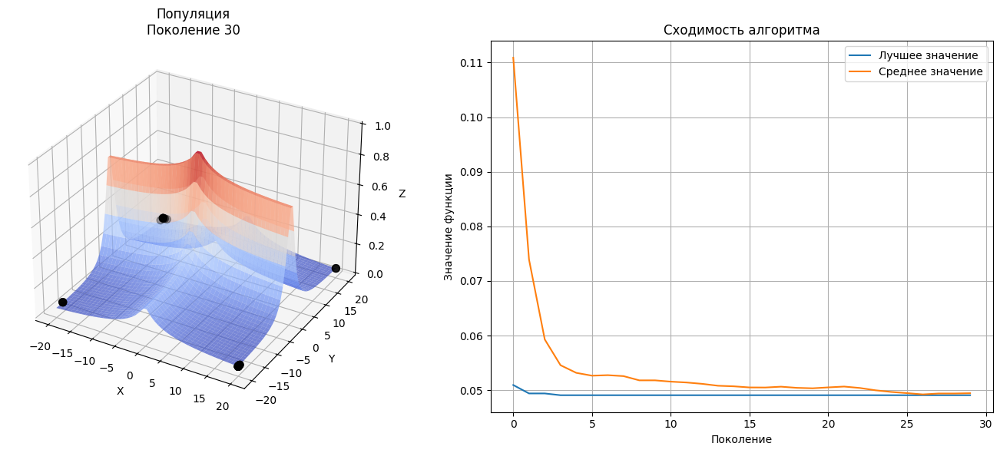


Лучшее решение: x=-20.0000, y=20.0000
Значение функции: 0.0491

МЕТОД СЕЛЕКЦИИ: sigma и МЕТОД ВЫБОРА РОДИТЕЛЕЙ: panmixia
Поколение 1: Лучшее значение = 0.0512, Среднее = 0.2065


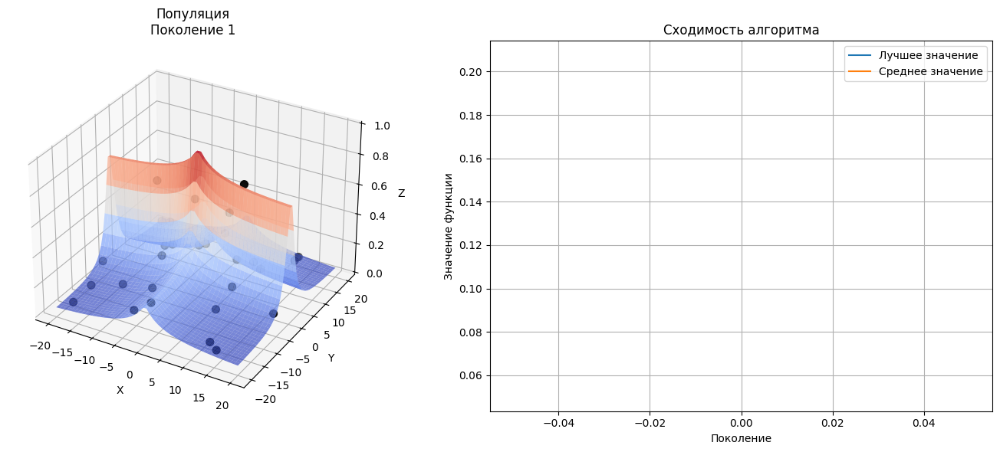

Поколение 8: Лучшее значение = 0.0506, Среднее = 0.0802


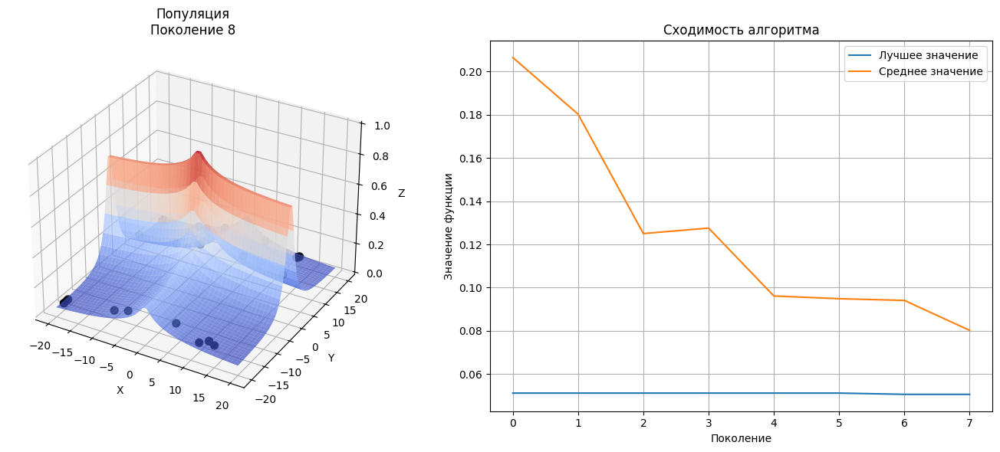

Поколение 15: Лучшее значение = 0.0496, Среднее = 0.0826


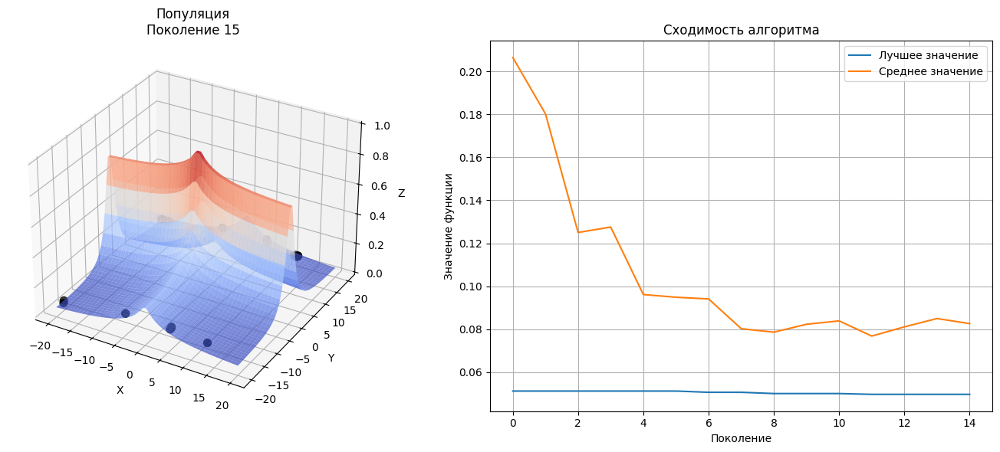

Поколение 22: Лучшее значение = 0.0492, Среднее = 0.0671


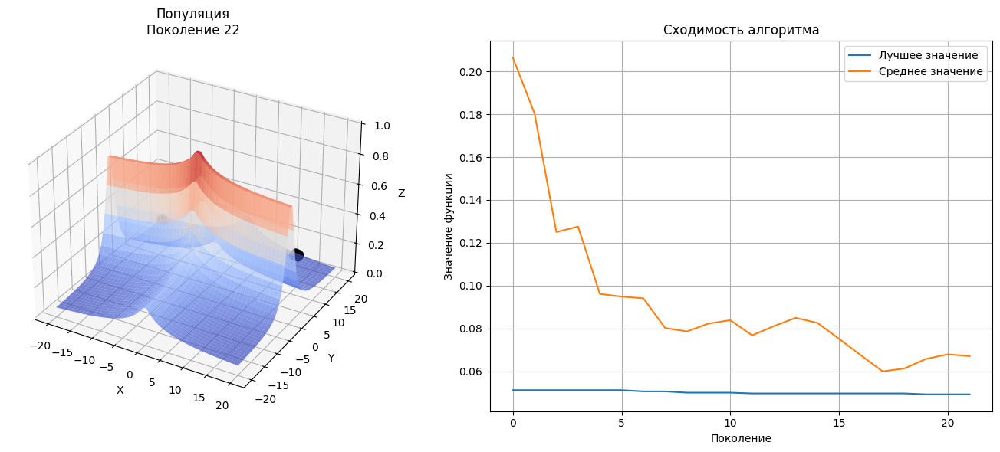

Поколение 29: Лучшее значение = 0.0492, Среднее = 0.0599


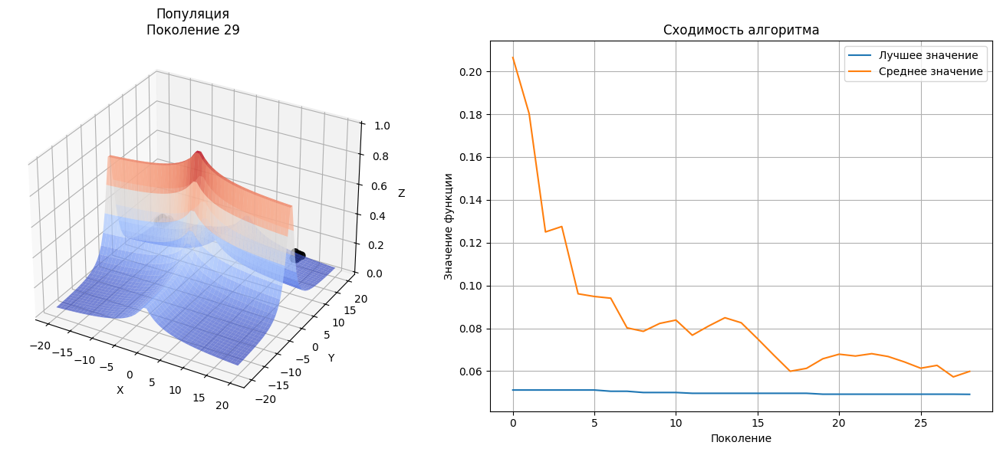

Поколение 30: Лучшее значение = 0.0491, Среднее = 0.0598


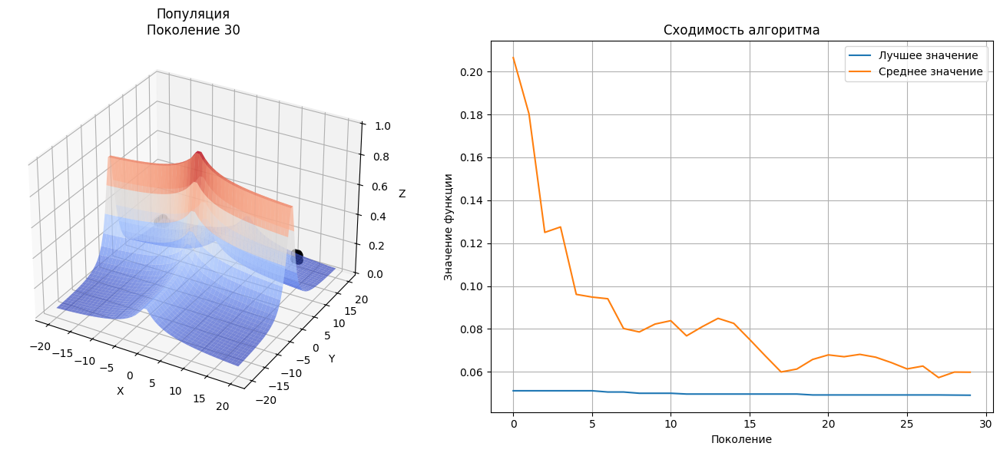


Лучшее решение: x=-20.0000, y=19.9876
Значение функции: 0.0491

МЕТОД СЕЛЕКЦИИ: sigma и МЕТОД ВЫБОРА РОДИТЕЛЕЙ: inbreeding
Поколение 1: Лучшее значение = 0.0552, Среднее = 0.2572


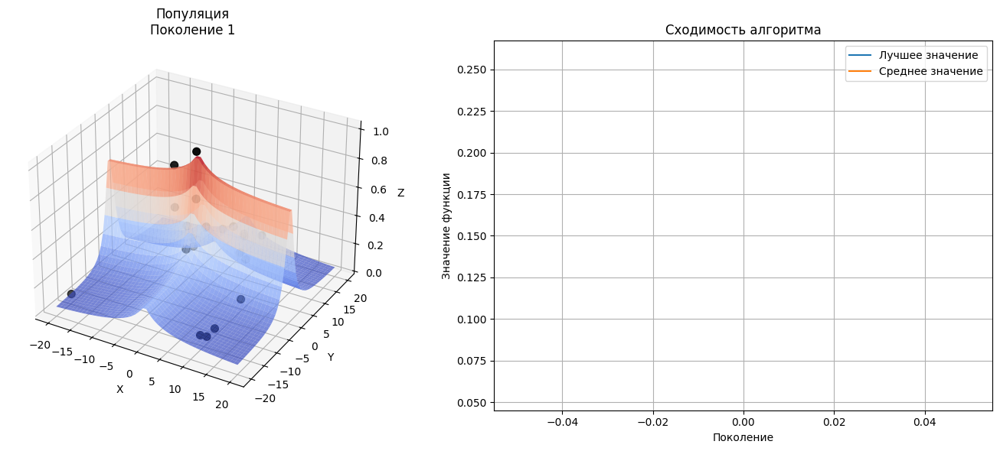

Поколение 8: Лучшее значение = 0.0552, Среднее = 0.2632


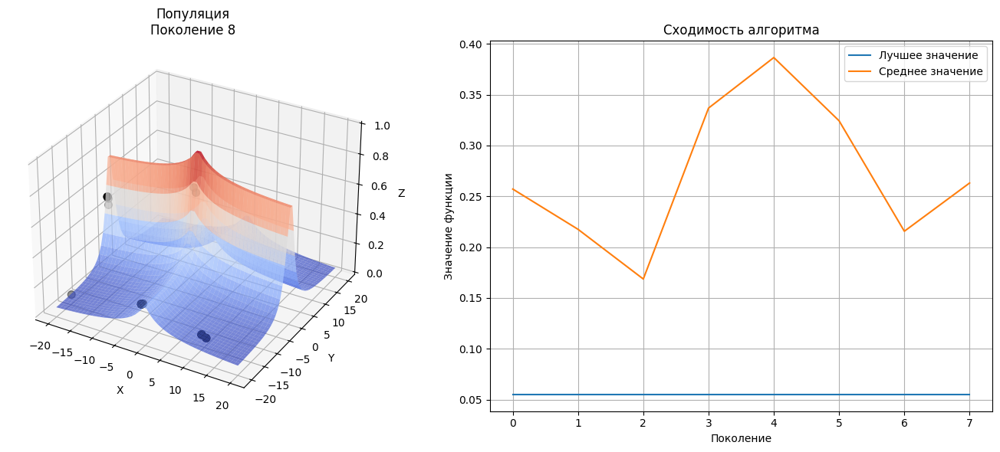

Поколение 15: Лучшее значение = 0.0537, Среднее = 0.0761


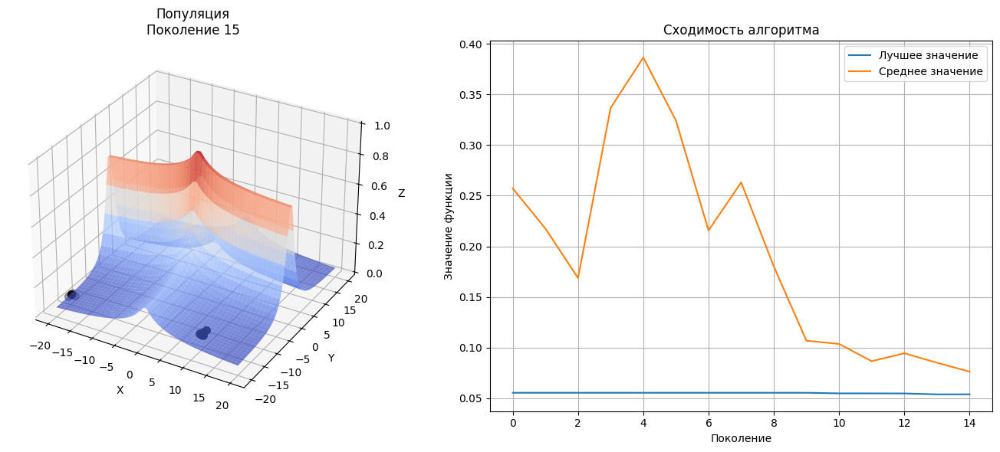

Поколение 22: Лучшее значение = 0.0535, Среднее = 0.0650


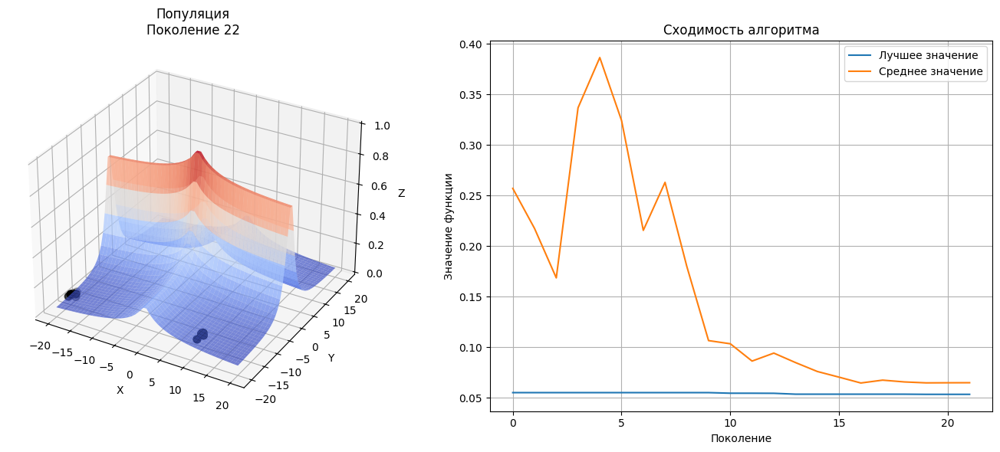

Поколение 29: Лучшее значение = 0.0526, Среднее = 0.0663


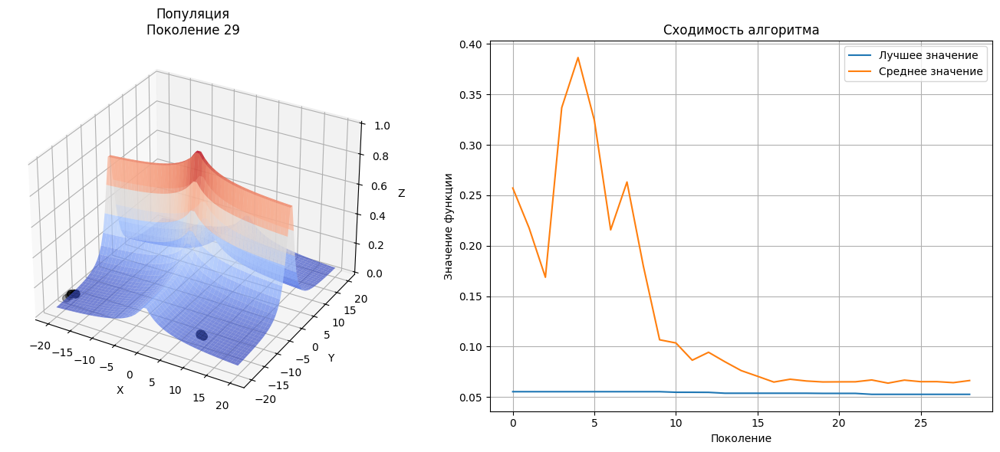

Поколение 30: Лучшее значение = 0.0526, Среднее = 0.0672


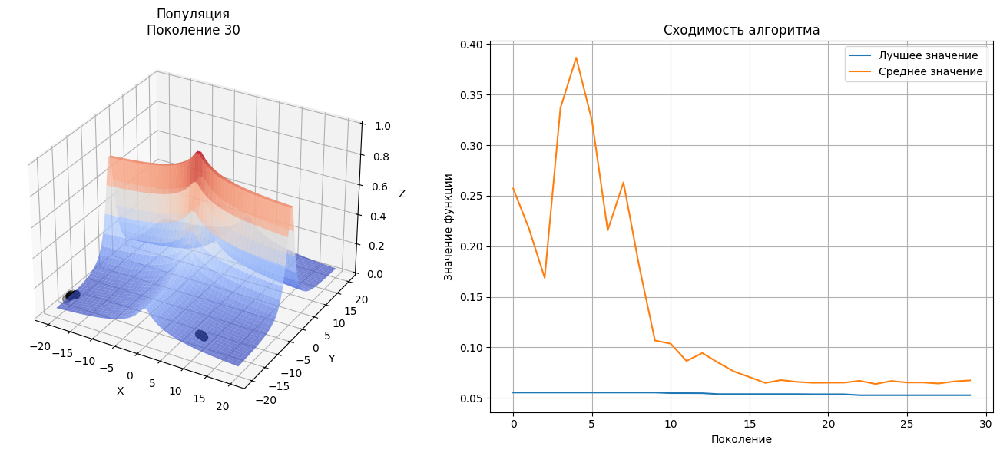


Лучшее решение: x=-20.0000, y=-16.4605
Значение функции: 0.0526

МЕТОД СЕЛЕКЦИИ: sigma и МЕТОД ВЫБОРА РОДИТЕЛЕЙ: outbreeding
Поколение 1: Лучшее значение = 0.0572, Среднее = 0.1682


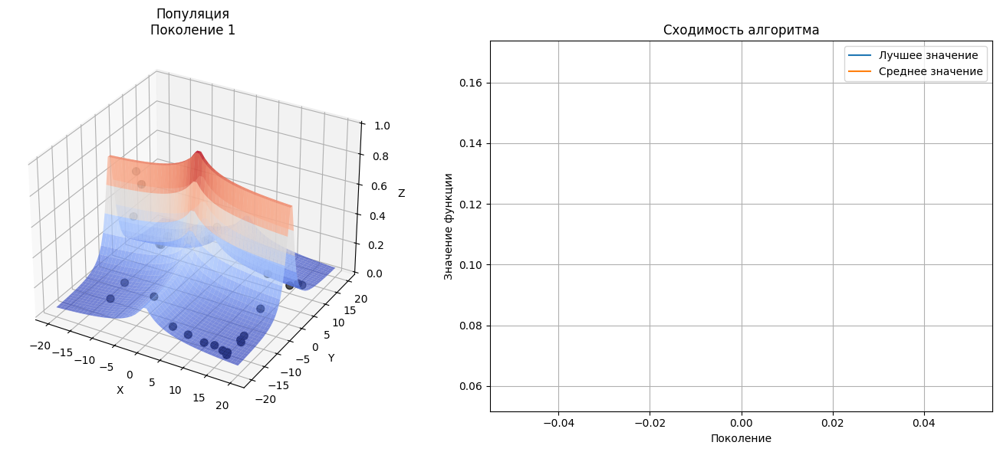

Поколение 8: Лучшее значение = 0.0511, Среднее = 0.0580


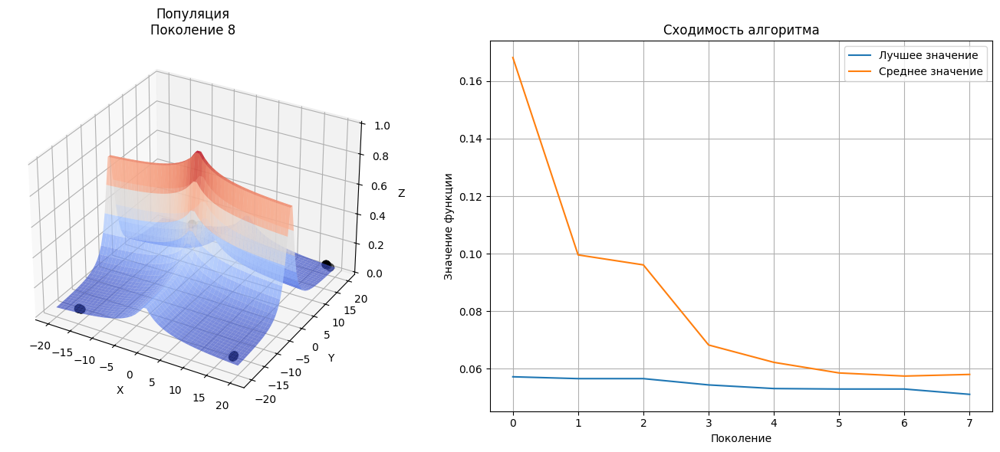

Поколение 15: Лучшее значение = 0.0491, Среднее = 0.0551


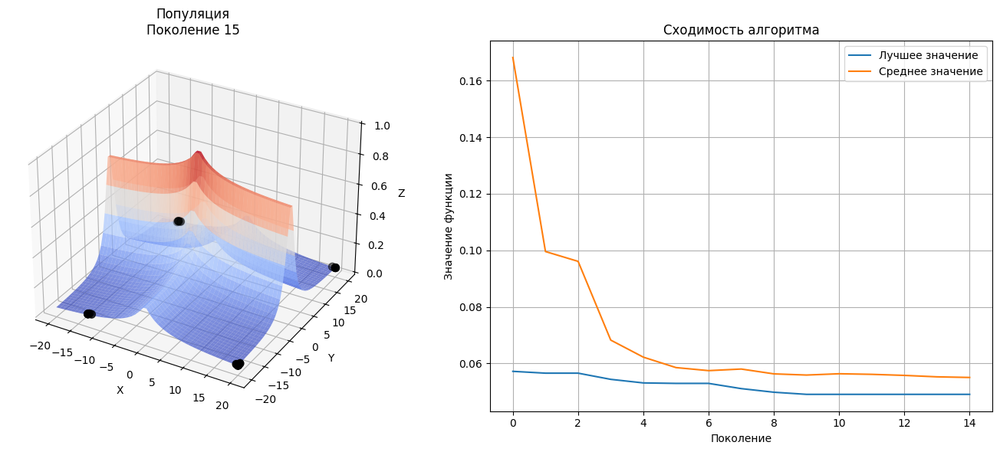

Поколение 22: Лучшее значение = 0.0491, Среднее = 0.0527


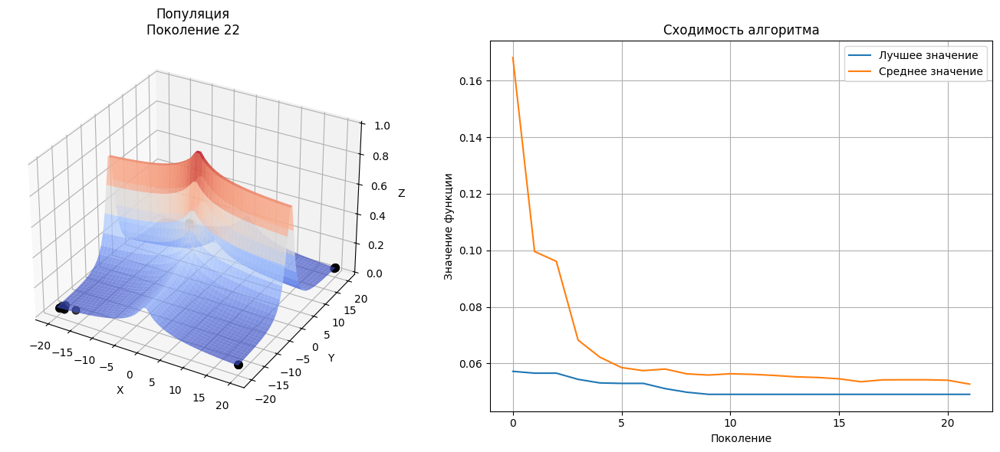

Поколение 29: Лучшее значение = 0.0491, Среднее = 0.0517


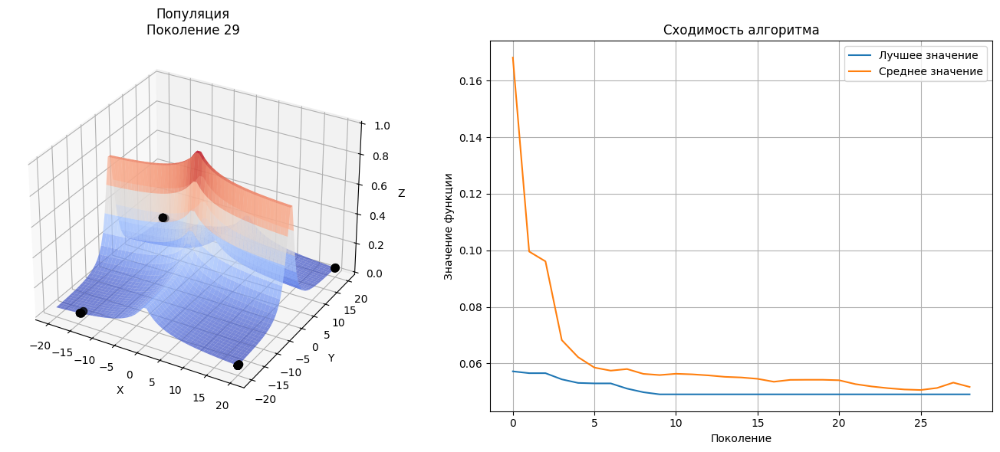

Поколение 30: Лучшее значение = 0.0491, Среднее = 0.0517


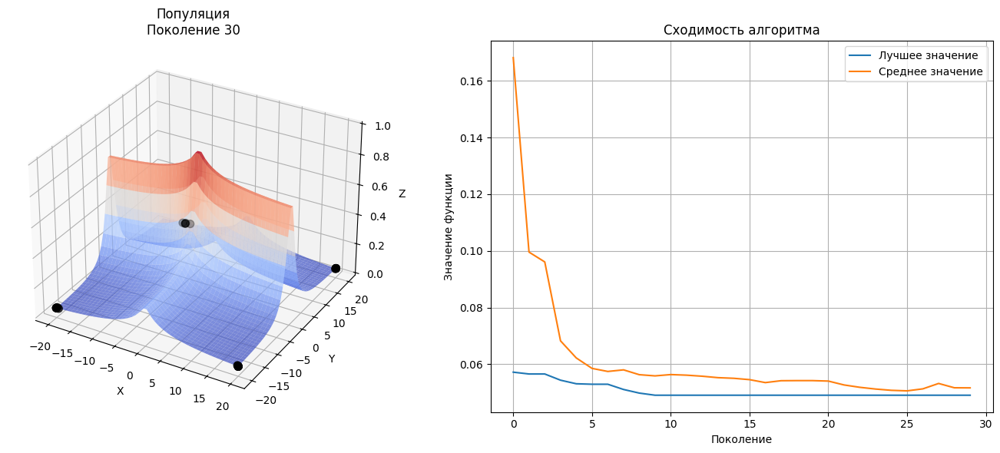


Лучшее решение: x=20.0000, y=20.0000
Значение функции: 0.0491


In [ ]:
parent_methods = ['panmixia', 'inbreeding','outbreeding' ]
selection_methods = ['tournament', 'roulette', 'ranking','uniform_ranking','sigma']
for j in selection_methods:
  for i in parent_methods :
    print(f'\nМЕТОД СЕЛЕКЦИИ: {j} и МЕТОД ВЫБОРА РОДИТЕЛЕЙ: {i}')
    ga = GeneticAlgorithm(
        fitness_func=f,
        population_size=30,
        bounds=(-20, 20),
        mutation_prob=0.15,
        selection_method=j,
        parent_selection_method=i,
        visualize_step=7  # Визуализация каждые 7 поколений
    )

    # Запускаем эволюцию
    ga.evolve(generations=30)

    # Получаем лучшее решение
    best_solution, best_fitness = ga.get_best_solution()
    print(f"\nЛучшее решение: x={best_solution[0]:.4f}, y={best_solution[1]:.4f}")
    print(f"Значение функции: {best_fitness:.4f}")

